In [ ]:
import sys
sys.path.insert(0, '..')

import scanpy as sc
import pandas as pd
import numpy as np
import pathlib
import scipy
from sklearn.decomposition import PCA
from ggml.generator import get_pointcloud
from tqdm import tqdm

import seaborn as sns
import matplotlib.pyplot as plt
from ggml.plot import plot_heatmap, hier_clustering, plot_emb, plot_ellipses #imports pydiffmap


import ot
from metric_learn import LMNN, LFDA, MLKR, NCA, ITML_Supervised

5.09581568684518e-15


/home/kuehn/anaconda3/envs/ggml_umap_2/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
#move into package TODO

def get_cells_by_patients(adata_path,patient_col="donor_id",label_col="reported_diseases",subsample_patient_ratio=0.5,n_feats=None,max_cells = None,filter_genes=False,**kwargs):
    global adata
    adata = sc.read_h5ad(adata_path+".h5ad")  #adata_path+".h5ad")
    

    string_class_labels = np.unique(adata.obs[label_col])

    if filter_genes:
        #detect low variable genes
        gene_var = np.var(adata.X.toarray(),axis=0)
        #filter
        thresh = np.mean(gene_var) #TODO make this not hardcoded and arbitrary
        adata = adata[:,gene_var >thresh]
        #adata.write(adata_path+"_filtered.h5ad")
        print(adata)

    distributions = []
    distributions_class = []
    patient_labels = []
    disease_labels = []
    celltype_node_label = []

    if n_feats is not None:
        global pca
        pca = PCA(n_components=n_feats, svd_solver='auto')
        pca.fit(adata.X)
    unique_patients = np.unique(adata.obs[patient_col])
    unique_patients_subsampled = np.random.choice(unique_patients, size = int(len(unique_patients)*subsample_patient_ratio),replace=False)


    for patient in unique_patients_subsampled:
        
        
        patient_adata = adata[adata.obs[patient_col] == patient]

        disease_label = np.unique(patient_adata.obs[label_col].to_numpy())
        string_class_label = disease_label[0]
        
        if len(disease_label) > 1:
            print("Warning, sample_ids refer to cells with multiple disease labels (likely caused by referencing by patients and having multiple samples from different zones)")

        '''
        unique,pos = np.unique(patient_adata.obs[label_col].to_numpy(),return_inverse=True) #Finds all unique elements and their positions
        counts = np.bincount(pos)                     #Count the number of each unique element
        maxpos = counts.argmax()                      #Finds the positions of the maximum count
        string_class_label = unique[maxpos] #we take the label that occurs most often for this patient
        patient_adata = adata[adata.obs[label_col] == string_class_label ] # and only keep those (this is only relevant for myocardial infarction)
        '''

        if max_cells is not None and patient_adata.n_obs > max_cells:
            sc.pp.subsample(patient_adata,n_obs = max_cells) 

        #p_arr = np.asarray(patient_adata.X.toarray(),dtype="f") #TODO directly sparse scipy matrix to numpy matrix?

        #if n_feats == 50:
        #    p_arr = np.asarray(patient_adata.obsm["X_pca"],dtype="f")
        #else:
        p_arr = np.asarray(patient_adata.X.toarray(),dtype="f") #TODO directly sparse scipy matrix to numpy matrix?
        if n_feats is not None:
            p_arr = pca.transform(p_arr)

        distributions.append(p_arr)
        
        disease_labels.append(string_class_label)
        #distributions_class.append(np.where(string_class_labels==string_class_label)[0][0])
        patient_labels.append(list(patient_adata.obs[patient_col]))
        celltype_node_label.append(list(patient_adata.obs['cell_type'])) #cell_Type
            
        #Cell level
    points = np.concatenate(distributions) #np.reshape(np.asarray(dists),(-1,2))
    point_labels = sum([[l] * len(D) for l,D in zip(disease_labels,distributions)],[]) #flattens list of lists

    #return distributions, distributions_class, patient_labels, disease_labels, celltype_node_label
    return distributions, disease_labels, points, point_labels, celltype_node_label, np.concatenate(patient_labels)

    distributions, distributions_class, patient_labels, disease_labels, 

#distributions, distributions_labels, patient_labels = get_cells_by_patients(dataset_folder+dataset_name,patient_col="donor_id",label_col=label_col)
#print(distributions_labels)

def compute_OT(distributions,labels,precomputed_distances=None,ground_metric = None,w = None,legend=None,numThreads=32):
    D = np.zeros((len(distributions),len(distributions)))
    for i,distribution_i in enumerate(distributions):
        for j,distribution_j in enumerate(distributions):
            if i < j:
                if precomputed_distances is not None:
                    start_i = int(np.sum([len(dist) for dist in distributions[:i]]))
                    start_j = int(np.sum([len(dist) for dist in distributions[:j]]))
                    if precomputed_distances.ndim == 1:
                        precomputed_distances = scipy.spatial.distance.squareform(precomputed_distances)
                    M = precomputed_distances[start_i:start_i+len(distribution_i),start_j:start_j+len(distribution_j)]
                elif w is not None:
                    M = pairwise_mahalanobis_distance_npy(distribution_i,distribution_j,w)

                D[i,j] = ot.emd2([],[],M,numThreads=numThreads)
                #TODO handle non mahalanobis distances
            else:
                D[i,j]=D[j,i]
    
    hardcoded_symbols = None #[i % 4 for i in range(len(distributions))]
    plot_emb(D,method='umap',colors=labels,symbols=hardcoded_symbols,legend=legend,title="UMAP",verbose=True,annotation=None,s=200)
    plot_emb(D,method='diffusion',colors=labels,symbols=hardcoded_symbols,legend=legend,title="DiffMap",verbose=True,annotation=None,s=200)

    hier_clustering(D,labels, ax=None,dist_name="W_θ")
    return D

from sklearn.metrics.pairwise import pairwise_distances

def pairwise_mahalanobis_distance_npy(X_i,X_j=None,w=None,numThreads=32):
    # W has shape dim x dim
    # X_i, X_y have shape n x dim, m x dim
    # return Mahalanobis distance between pairs n x m 
    if X_j is None:
        if w is None or isinstance(w,str):
            return pairwise_distances(X_i,metric=w,n_jobs=numThreads) #cdist .. ,X_j)
        else:
            if w.ndim == 2 and w.shape[0]==w.shape[1]:
                return pairwise_distances(X_i,metric="mahalanobis",n_jobs=numThreads,VI =w)    
            else:
                X_j = X_i
    #Transform poins of X_i,X_j according to W
    #refactor pls
    if w is None or isinstance(w,str):
        return pairwise_distances(X_i,X_j,metric=w,n_jobs=numThreads) #cdist .. ,X_j)
    #elif w.ndim == 2 and w.shape[0]==w.shape[1] and len(w)>1000:
    #mahalanobis matrix is to large to compute distances, use cholesky factorization instead M=wT w
            

            #return pairwise_distances(X_i,metric="mahalanobis",n_jobs=numThreads,VI =w)
            #     
    #return scipy.spatial.distance.squareform(scipy.spatial.distance.cdist(X_i,X_j,metric=w))

    #Assume w is cov matrix of mahalanobis distance
    elif w.ndim == 1:
        #assume cov=0, scale dims by diagonal
        w = np.diag(w)
        proj_X_i = np.matmul(X_i,w)
        proj_X_j = np.matmul(X_j,w)

        #proj_X_i = X_i * w[None,:]
        #proj_X_j = X_j * w[None,:]
    else: 
        w = np.transpose(w)
        proj_X_i = np.matmul(X_i,w)
        proj_X_j = np.matmul(X_j,w)
    
    #print("projected shape")
    #print(proj_X_i.shape)
    return np.linalg.norm(proj_X_i[:,np.newaxis,:]  -  proj_X_j[np.newaxis,:,:],axis=-1)  


In [3]:
#Synth Data
n = 100
means = [5,10,15]
offsets = np.arange(0,30,3)+1.5

shared_means_x = [0, 40]
shared_means_y = [0, 50] 

use_synth = False
if use_synth:   
    datasets = {
        #"synth_2D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1000,noise_dims=1),
        #"synth_100D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1,noise_dims=99)
        "synth_200D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1,noise_dims=199)
    }

    train_datasets = {
        #"synth_2D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1000,noise_dims=1),
        #"synth_100D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1,noise_dims=99)
        "synth_200D": get_pointcloud(distribution_size=n, class_means = means, offsets = offsets, shared_means_x=shared_means_x, shared_means_y=shared_means_y, plot=True, varying_size=False,return_dict=True,noise_scale=1,noise_dims=199)
    }
else:
    datasets = {}
    train_datasets = {}

In [4]:


load_scRNA = True
if load_scRNA:
    #Load scRNA datasets
    dataset_folder = "/home/kuehn/ot_metric_learning/damin-ggml/data/datasets/"
    dataset_loading = {
        #"breastcancer":{"path":"b8b5be07-061b-4390-af0a-f9ced877a068","label_col":"reported_diseases","patient_col":"donor_id"},
        #"kidney":{"path":"1c360b0b-eb2f-45a3-aba9-056026b39fa5","label_col":"disease","patient_col":"donor_id"},
        "myocard_infarct":{"path":"c1f6034b-7973-45e1-85e7-16933d0550bc","label_col":"patient_group","patient_col":"sample"}, #major_labls
    }




    
    pca_c = None #50
    max_cells = 1000 #None # 
    subsample_patient_ratio = 1.0

    for dataset_name,loading_info in dataset_loading.items():
        #Test
        data_dict = {}
        data_dict["distributions"],data_dict["distributions_labels"],data_dict["points"], data_dict["point_labels"], data_dict["distribution_modes"], data_dict["patient"] = get_cells_by_patients(dataset_folder+loading_info["path"],loading_info["patient_col"],loading_info["label_col"],subsample_patient_ratio=subsample_patient_ratio,n_feats=pca_c,max_cells = max_cells,filter_genes=True)
        datasets[dataset_name] = data_dict

        #Train
        data_dict2 = {}
        data_dict2["distributions"],data_dict2["distributions_labels"],data_dict2["points"], data_dict2["point_labels"], data_dict2["distribution_modes"], data_dict2["patient"] = get_cells_by_patients(dataset_folder+loading_info["path"],loading_info["patient_col"],loading_info["label_col"],subsample_patient_ratio=0.5,n_feats=pca_c,max_cells = max_cells,filter_genes=True)
        train_datasets[dataset_name] = data_dict2


View of AnnData object with n_obs × n_vars = 191795 × 7777
    obs: 'sample', 'n_counts', 'n_genes', 'percent_mito', 'doublet_score', 'dissociation_score', 'cell_type_original', 'patient_region_id', 'donor_id', 'patient_group', 'major_labl', 'final_cluster', 'assay_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'suspension_type', 'tissue_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid'
    var: 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'feature_length'
    uns: 'X_approximate_distribution', 'batch_condition', 'cell_type_original_colors', 'citation', 'default_embedding', 'schema_reference', 'schema_version', 'title'
    obsm: 'X_harmony', 'X_pca', 'X_umap'

In [5]:
metric_params = {}

%load_ext autoreload
%autoreload 2

In [6]:
from metric_learn import LMNN, LFDA, MLKR, NCA, ITML_Supervised
'''
metrics = {
    #"GGML": None,
    "Euclidean": lambda _: "euclidean", # lambda dims:np.eye(dims),
    "Manhatten": lambda _ : "cityblock",
    #"Jaccard": lambda _ : "jaccard",
    "Cosine": lambda _ : "cosine",
    #"LMNN": lambda data:LMNN(n_neighbors=30,random_state=42,learn_rate=1e-6,max_iter=100).fit(data["points"],np.unique(data["point_labels"], return_inverse=True)[1]).get_mahalanobis_matrix(),
    "LFDA": lambda data:LFDA(k=3).fit(data["points"],np.unique(data["point_labels"], return_inverse=True)[1]).get_mahalanobis_matrix(),
    #"NCA" : lambda data: NCA(random_state=42).fit(data["points"],np.unique(data["point_labels"], return_inverse=True)[1]).get_mahalanobis_matrix(),
    
    #"ITML": lambda data: ITML_Supervised(random_state=42).fit(data["points"],np.unique(data["point_labels"], return_inverse=True)[1]).get_mahalanobis_matrix(),
    
}
'''
n_threads = 64

norm='fro'
#Hyperparam  tuning
iter=30
neighbor_t = [3] #,5,7
rank_k = [5] #,10,25,50,100,200] 

alphas = [0.1,1,10,100,1000]
lambdas = [0.1,1,10,100,1000]

metrics = {f"theta_{a}_{l}_3_5_iter{iter}_L{norm}": None for a in alphas for l in lambdas}

#Load params for learned metric
metric_params_path = "/home/kuehn/ot_metric_learning/damin-ggml/data/results/learned_parameters"

#If pipeline should only be rerun for some datasets
selected_datasets = datasets #["breastcancer_full"] #


for d in tqdm(selected_datasets):
    print(d)
    if d not in metric_params:
        metric_params[d] = {}
    for m in tqdm(metrics):
        print(m)
        if m not in metric_params[d]:
            try:
                if callable(metrics[m]):
                    #print(datasets[d]["points"])
                    dims = datasets[d]["points"][0].shape[-1]
                    #print(dims)
                    metric_params[d][m]= metrics[m](train_datasets[d])
                else:
                    metric_params[d][m]=np.load(f"{metric_params_path}/{d}/GGML/{m}.npy") #hardcoded for hyperparameter tuning of synth 200D
            except Exception as e: 
                print(e)
                metric_params[d][m] = None


  0%|          | 0/1 [00:00<?, ?it/s]

myocard_infarct


100%|██████████| 1/1 [00:00<00:00, 17.02it/s]

theta_0.1_0.1_3_5_iter30_Lfro
theta_0.1_1_3_5_iter30_Lfro
theta_0.1_10_3_5_iter30_Lfro
theta_0.1_100_3_5_iter30_Lfro
theta_0.1_1000_3_5_iter30_Lfro
theta_1_0.1_3_5_iter30_Lfro
theta_1_1_3_5_iter30_Lfro
theta_1_10_3_5_iter30_Lfro
theta_1_100_3_5_iter30_Lfro
theta_1_1000_3_5_iter30_Lfro
theta_10_0.1_3_5_iter30_Lfro
theta_10_1_3_5_iter30_Lfro
theta_10_10_3_5_iter30_Lfro
theta_10_100_3_5_iter30_Lfro
theta_10_1000_3_5_iter30_Lfro
theta_100_0.1_3_5_iter30_Lfro
theta_100_1_3_5_iter30_Lfro
theta_100_10_3_5_iter30_Lfro
theta_100_100_3_5_iter30_Lfro
theta_100_1000_3_5_iter30_Lfro
theta_1000_0.1_3_5_iter30_Lfro
theta_1000_1_3_5_iter30_Lfro
theta_1000_10_3_5_iter30_Lfro
theta_1000_100_3_5_iter30_Lfro
theta_1000_1000_3_5_iter30_Lfro


In [7]:
from ggml.benchmark import pivoted_chol

rank = 5

#metric_params_copy= metric_params

#low rank cholesky approximation (pivoted)
for d in metric_params:
    for m in metric_params[d]:
        if isinstance(metric_params[d][m],np.ndarray):
            print(m)
            print(metric_params[d][m].shape)
            if len(metric_params[d][m])>100:
                get_diag = lambda: np.diagonal(metric_params[d][m]).copy()
                get_row = lambda i: metric_params[d][m][i,:]

                metric_params[d][m] = pivoted_chol(get_diag, get_row, rank, err_tol = 1e-6)
                print(metric_params[d][m].shape)

theta_0.1_0.1_3_5_iter30_Lfro
(5, 7777)
theta_0.1_1_3_5_iter30_Lfro
(5, 7777)
theta_0.1_10_3_5_iter30_Lfro
(5, 7777)
theta_0.1_100_3_5_iter30_Lfro
(5, 7777)
theta_0.1_1000_3_5_iter30_Lfro
(5, 7777)
theta_1_0.1_3_5_iter30_Lfro
(5, 7777)
theta_1_1_3_5_iter30_Lfro
(5, 7777)
theta_1_10_3_5_iter30_Lfro
(5, 7777)
theta_1_100_3_5_iter30_Lfro
(5, 7777)
theta_1_1000_3_5_iter30_Lfro
(5, 7777)
theta_10_0.1_3_5_iter30_Lfro
(5, 7777)
theta_10_1_3_5_iter30_Lfro
(5, 7777)
theta_10_10_3_5_iter30_Lfro
(5, 7777)
theta_10_100_3_5_iter30_Lfro
(5, 7777)
theta_10_1000_3_5_iter30_Lfro
(5, 7777)
theta_100_0.1_3_5_iter30_Lfro
(5, 7777)
theta_100_1_3_5_iter30_Lfro
(5, 7777)
theta_100_10_3_5_iter30_Lfro
(5, 7777)
theta_100_100_3_5_iter30_Lfro
(5, 7777)
theta_100_1000_3_5_iter30_Lfro
(5, 7777)
theta_1000_0.1_3_5_iter30_Lfro
(5, 7777)
theta_1000_1_3_5_iter30_Lfro
(5, 7777)
theta_1000_10_3_5_iter30_Lfro
(5, 7777)
theta_1000_100_3_5_iter30_Lfro
(5, 7777)
theta_1000_1000_3_5_iter30_Lfro
(5, 7777)


In [8]:
#wrapper for precomputed distance matrix
#only execute once values are accessed
class Computed_Distances():
    def __init__(self, points, theta, n_threads=n_threads):
        self.n_treads = n_threads
        self.points = points
        self.theta = theta

        
        self.data = np.full((len(points),len(points)), np.nan)

        self.ndim = self.data.ndim
        self.sape = self.data.shape
        #self.shape =  ((len(points),len(points)))

    

    def __getitem__(self, slice_):
        #TODO check if some values are already computed and only compute new values

        if np.isnan(self.data[slice_]).any():
            ranges = [np.squeeze(np.arange(len(self.data))[slice_[i]]) for i in range(len(slice_))] #list(range(slice_[i].stop)[slice_[i]]) for i in range(len(slice_))]
            entry_nan_index = ([],[])
            for entry in ranges[0]:
                #print(self.data[entry,:].ndim)
                check = np.isnan(self.data[entry,:])
                if check.ndim == 2 and np.isnan(self.data[entry,:][:,slice_[1]]).any():
                    entry_nan_index[0].append(entry) 
                elif check.ndim == 1 and np.isnan(self.data[entry,:][slice_[1]]).any(): #TODO why not or?
                    entry_nan_index[0].append(entry)   
            for entry in ranges[1]:
                if np.isnan(self.data[slice_[0],entry]).any():
                    entry_nan_index[1].append(entry)   
            #print("checked for nans")
            
            #check for elements with nan entries
            dist = pairwise_mahalanobis_distance_npy(self.points[entry_nan_index[0],:],self.points[entry_nan_index[1],:],w=self.theta, numThreads = n_threads)
            self.data[np.ix_(entry_nan_index[0],entry_nan_index[1])] = dist 
            #self.data[slice_[0],:][:,slice_[1]] =  pairwise_mahalanobis_distance_npy(self.points[slice_[0],:],self.points[slice_[1],:],w=self.theta, numThreads = n_threads) #self.data[slice_[0],:][:,slice_[1]] should be self.data[slice_]
            #print(self.data[np.ix_(entry_nan_index[0],entry_nan_index[1])]) #self.data[entry_nan_index[0],:][:,entry_nan_index[1]])
            #print(self.data[slice_[0],:][:,slice_[1]])

            computed_percentage = len(entry_nan_index[0])/len(ranges[0])*len(entry_nan_index[1])/len(ranges[1])
            #print(f"loaded {1-computed_percentage:,.2f} of {len(entry_nan_index[0])*len(entry_nan_index[0])} distances")
            return self.data[slice_]

        else:
            return self.data[slice_]

#Precompute ground distances with learned metrics ##actually we are just setting the wrapper instead
precomputed_ground_distances = {}
for d in metric_params:
    print(d)




    precomputed_ground_distances[d]={}
    for m in metric_params[d]:
        print(m)
        #print(datasets[d]["points"].shape)
        #print(metric_params[d][m].shape)
        #print(metric_params[d][m])
       
        if metric_params[d][m] is not None:
            if True:
               
                precomputed_ground_distances[d][m] = Computed_Distances(np.asarray(datasets[d]["points"],dtype='f'),theta=metric_params[d][m]) #pairwise_mahalanobis_distance_npy(np.asarray(datasets[d]["points"],dtype='f'),w=metric_params[d][m])
            #except Exception as e: 
            #    print(e)
            #    print("error")
            #    precomputed_ground_distances[d][m] = None
        else: 
            precomputed_ground_distances[d][m] = None


myocard_infarct
theta_0.1_0.1_3_5_iter30_Lfro
theta_0.1_1_3_5_iter30_Lfro
theta_0.1_10_3_5_iter30_Lfro


theta_0.1_100_3_5_iter30_Lfro
theta_0.1_1000_3_5_iter30_Lfro
theta_1_0.1_3_5_iter30_Lfro
theta_1_1_3_5_iter30_Lfro
theta_1_10_3_5_iter30_Lfro
theta_1_100_3_5_iter30_Lfro
theta_1_1000_3_5_iter30_Lfro
theta_10_0.1_3_5_iter30_Lfro
theta_10_1_3_5_iter30_Lfro
theta_10_10_3_5_iter30_Lfro
theta_10_100_3_5_iter30_Lfro
theta_10_1000_3_5_iter30_Lfro
theta_100_0.1_3_5_iter30_Lfro
theta_100_1_3_5_iter30_Lfro
theta_100_10_3_5_iter30_Lfro
theta_100_100_3_5_iter30_Lfro
theta_100_1000_3_5_iter30_Lfro
theta_1000_0.1_3_5_iter30_Lfro
theta_1000_1_3_5_iter30_Lfro
theta_1000_10_3_5_iter30_Lfro
theta_1000_100_3_5_iter30_Lfro
theta_1000_1000_3_5_iter30_Lfro


In [9]:
def datapoint_acc_over_splits(pred,true,index,length):
    prediction = np.zeros((length,2))
    for s_pred,s_true,s_index in zip(pred,true,index):
        prediction[s_index,0] += np.squeeze([s_pred == s_true]) # 1 #correct
        prediction[s_index,1] += np.squeeze([s_pred != s_true]) #+= 1 #false

    accuracy = prediction[:,0] / np.sum(prediction,axis=-1)
    return accuracy

In [10]:
import numpy.typing as npt
import warnings

#from pyvoi import VI #TODO

def VI(labels1: npt.NDArray[np.int32],labels2: npt.NDArray[np.int32],torch: bool=True,device: str="cpu",return_split_merge: bool=False):
    """
    Calculates the Variation of Information between two clusterings.

    Arguments:
    labels1: flat int32 array of labels for the first clustering
    labels2: flat int32 array of labels for the second clustering
    torch: whether to use torch, default:True
    device: device to use for torch, default:"cpu"
    return_split_merge: whether to return split and merge terms, default:False

    Returns:
    vi: variation of information
    vi_split: split term of variation of information
    vi_merge: merge term of variation of information
    splitters(optional): labels of labels2 which are split by labels1. splitters[i,0] is the contribution of the i-th splitter to the VI and splitters[i,1] is the corresponding label of the splitter
    mergers(optional): labels of labels1 which are merging labels from labels2. mergers[i,0] is the contribution of the i-th merger to the VI and mergers[i,1] is the corresponding label of the merger
    """
    if labels1.ndim > 1 or labels2.ndim > 1:
        warnings.warn(f"Inputs of shape {labels1.shape}, {labels2.shape} are not one-dimensional -- inputs will be flattened.")
        labels1 = labels1.flatten()
        labels2 = labels2.flatten()
        
    if torch:
        return VI_torch(labels1,labels2,device=device,return_split_merge=return_split_merge)
    else:
        return VI_np(labels1,labels2,return_split_merge=return_split_merge)
    
def VI_np(labels1,labels2,return_split_merge=False):
    assert len(labels2)==len(labels1)
    size=len(labels2)

    mutual_labels=(labels1.astype(np.uint64)<<32)+labels2.astype(np.uint64)

    sm_unique,sm_inverse,sm_counts=np.unique(labels2,return_inverse=True,return_counts=True)
    fm_unique,fm_inverse,fm_counts=np.unique(labels1,return_inverse=True,return_counts=True)
    _,mutual_inverse,mutual_counts=np.unique(mutual_labels,return_inverse=True,return_counts=True)

    terms_mutual = -np.log(mutual_counts/size)*mutual_counts/size
    terms_mutual_per_count=terms_mutual[mutual_inverse]/mutual_counts[mutual_inverse]
    terms_sm = -np.log(sm_counts/size)*sm_counts/size
    terms_fm = -np.log(fm_counts/size)*fm_counts/size
    if not return_split_merge:
        terms_mutual_sum=np.sum(terms_mutual_per_count)
        vi_split=terms_mutual_sum-terms_sm.sum()
        vi_merge=terms_mutual_sum-terms_fm.sum()
        vi=vi_split+vi_merge
        return vi,vi_split,vi_merge

    vi_split_each=np.zeros(len(sm_unique))
    np.add.at(vi_split_each,sm_inverse,terms_mutual_per_count)
    vi_split_each-=terms_sm
    vi_merge_each=np.zeros(len(fm_unique))
    np.add.at(vi_merge_each,fm_inverse,terms_mutual_per_count)
    vi_merge_each-=terms_fm

    vi_split=np.sum(vi_split_each)
    vi_merge=np.sum(vi_merge_each)
    vi=vi_split+vi_merge

    i_splitters=np.argsort(vi_split_each)[::-1]
    i_mergers=np.argsort(vi_merge_each)[::-1]

    vi_split_sorted=vi_split_each[i_splitters]
    vi_merge_sorted=vi_merge_each[i_mergers]

    splitters=np.stack([vi_split_sorted,sm_unique[i_splitters]],axis=1)
    mergers=np.stack([vi_merge_sorted,fm_unique[i_mergers]],axis=1)
    return vi,vi_split,vi_merge,splitters,mergers

In [11]:
from scipy.cluster.hierarchy import dendrogram
import sklearn
#import pyvoi
'''
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)
data = "synth_2D"
metric = "GGML"
labels= np.asarray(datasets[data]["point_labels"])
distances = precomputed_ground_distances[data][metric]
l = 0

for t in np.arange(0.05,1,0.05):
#hier_clustering(distances[:,:],labels)
    print(t)
    pred_cluster = sklearn.cluster.AgglomerativeClustering(n_clusters=len(np.unique(labels)) if l==1 else None,distance_threshold= None if l==1 else np.quantile(distances[:,:],t),metric='precomputed',linkage='average').fit_predict(distances[:,:])

    vi,_,_=VI(pred_cluster,labels,torch=False) #pyvoi.

    print(vi)

    mi_score = sklearn.metrics.mutual_info_score(labels,pred_cluster) #
    ari_score = sklearn.metrics.adjusted_rand_score(labels,pred_cluster) 
    
    #dist = np.copy(distances[:,:])
    #np.fill_diagonal(dist, 0)
    #sh_score = sklearn.metrics.silhouette_score(dist, labels, metric="precomputed")
    print(f"MI:{mi_score:.2f}  ARI:{ari_score:.2f}   VI:{vi:.2f}")
#pred_cluster = pred_cluster.fit(distances[:,:])
                            
#plot_dendrogram(pred_cluster, truncate_mode=None) #"level", p=3)

'''

'\ndef plot_dendrogram(model, **kwargs):\n    # Create linkage matrix and then plot the dendrogram\n\n    # create the counts of samples under each node\n    counts = np.zeros(model.children_.shape[0])\n    n_samples = len(model.labels_)\n    for i, merge in enumerate(model.children_):\n        current_count = 0\n        for child_idx in merge:\n            if child_idx < n_samples:\n                current_count += 1  # leaf node\n            else:\n                current_count += counts[child_idx - n_samples]\n        counts[i] = current_count\n\n    linkage_matrix = np.column_stack(\n        [model.children_, model.distances_, counts]\n    ).astype(float)\n\n    # Plot the corresponding dendrogram\n    dendrogram(linkage_matrix, **kwargs)\ndata = "synth_2D"\nmetric = "GGML"\nlabels= np.asarray(datasets[data]["point_labels"])\ndistances = precomputed_ground_distances[data][metric]\nl = 0\n\nfor t in np.arange(0.05,1,0.05):\n#hier_clustering(distances[:,:],labels)\n    print(t)\n    

In [12]:
patient_group_split = False # True
classify = True
cluster = False# True
results = {}
results_path = "/home/kuehn/ot_metric_learning/damin-ggml/data/results/clustering"

#To plot only cells that can be well rpedicted
datapoints_over_split = {}

#TODO make this setable on a dataset level, and not global
true_modes_available = False

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Data myocard_infarct Metric theta_0.1_0.1_3_5_iter30_Lfro


/home/kuehn/anaconda3/envs/ggml_umap_2/lib/python3.11/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


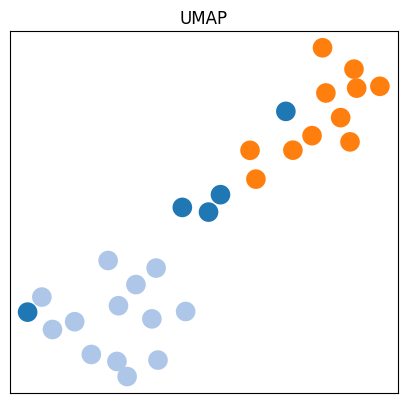

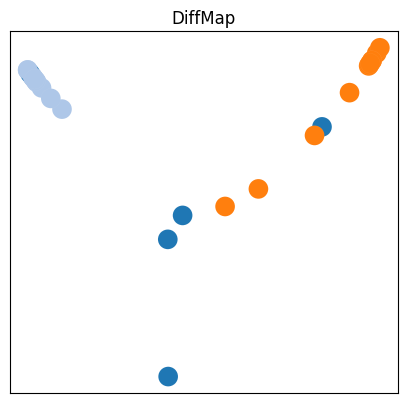

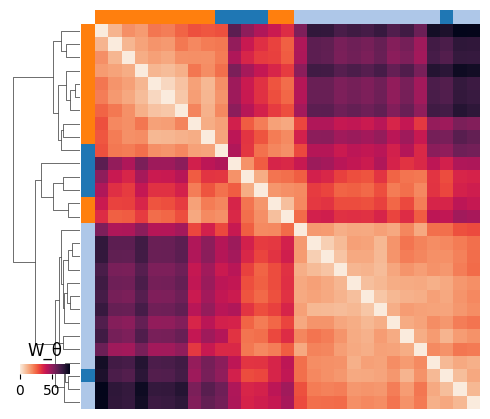

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.92±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.87±0.10
Data myocard_infarct Metric theta_0.1_1_3_5_iter30_Lfro


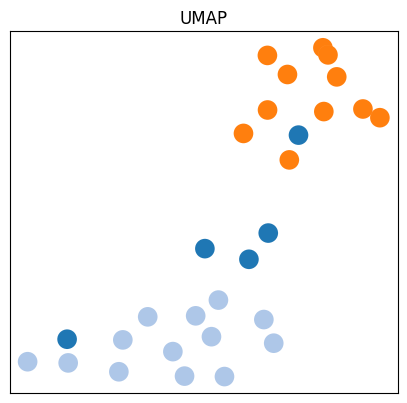

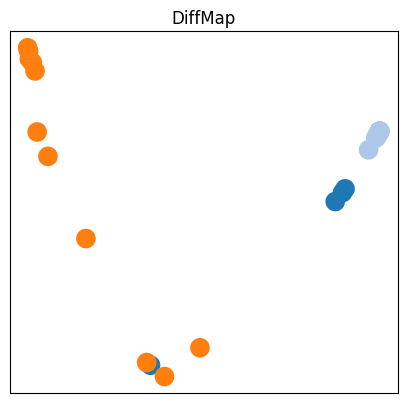

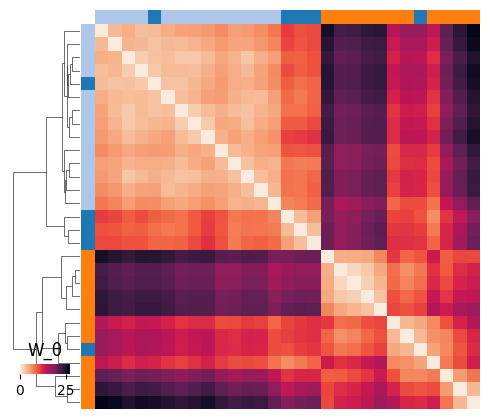

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.87±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.83±0.11
Data myocard_infarct Metric theta_0.1_10_3_5_iter30_Lfro


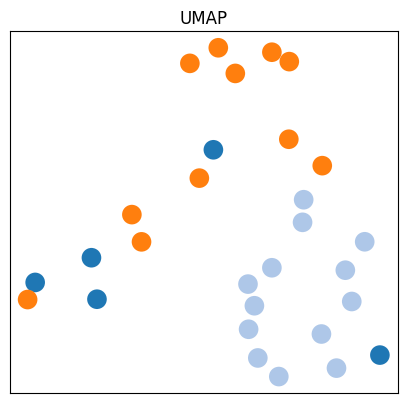

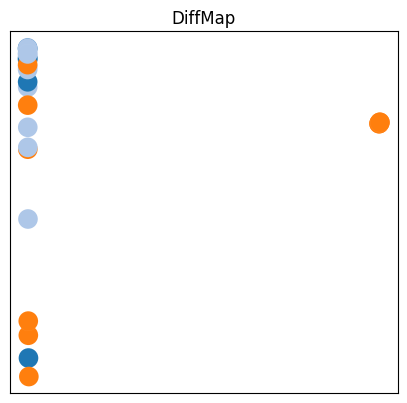

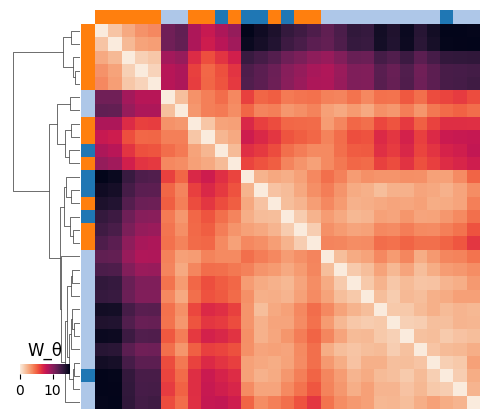

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.79±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.75±0.11
Data myocard_infarct Metric theta_0.1_100_3_5_iter30_Lfro


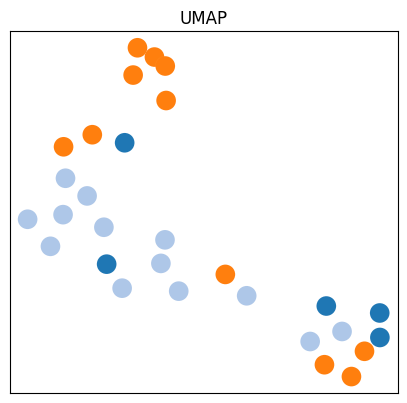

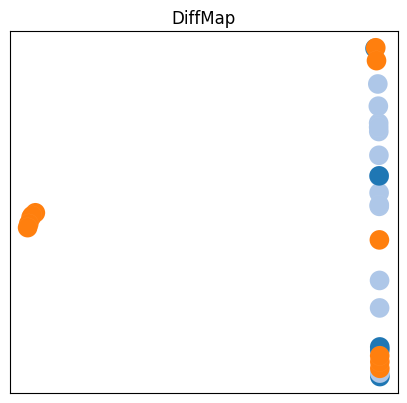

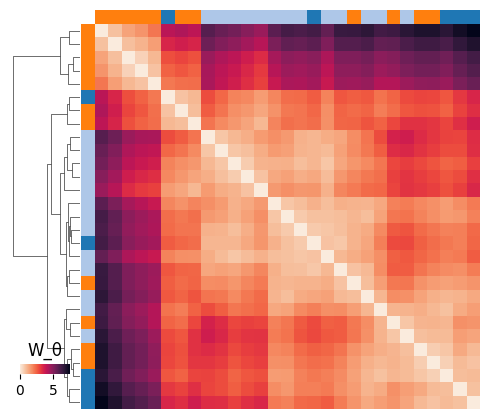

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.64±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.60±0.19
Data myocard_infarct Metric theta_0.1_1000_3_5_iter30_Lfro


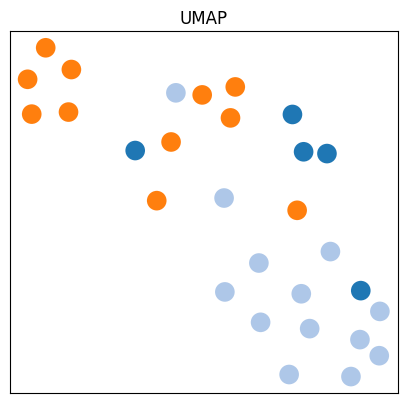

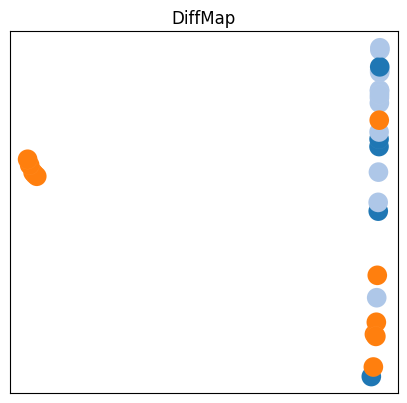

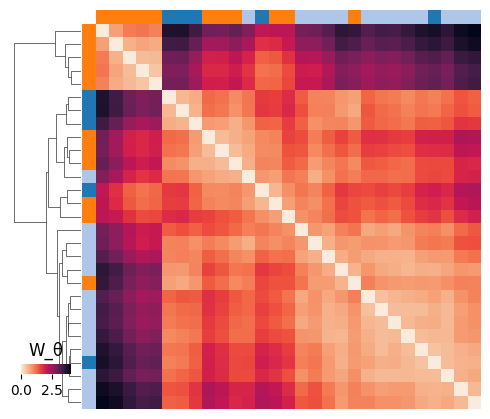

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.66±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.65±0.16
Data myocard_infarct Metric theta_1_0.1_3_5_iter30_Lfro


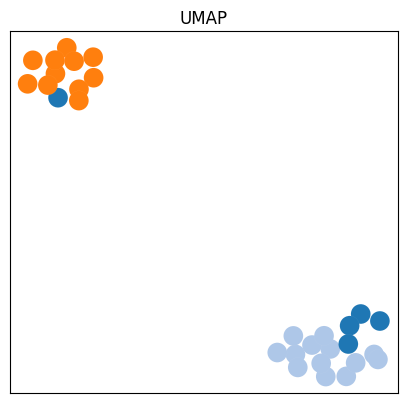

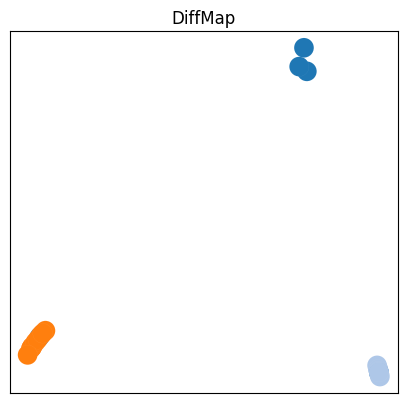

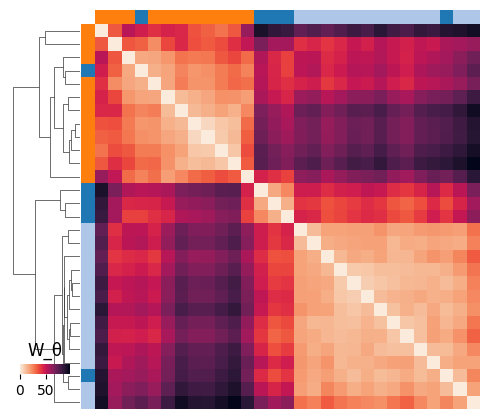

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.92±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.85±0.05
Data myocard_infarct Metric theta_1_1_3_5_iter30_Lfro


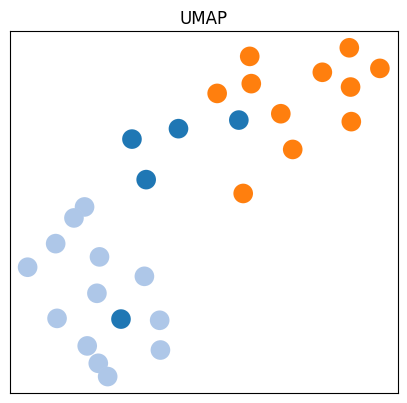

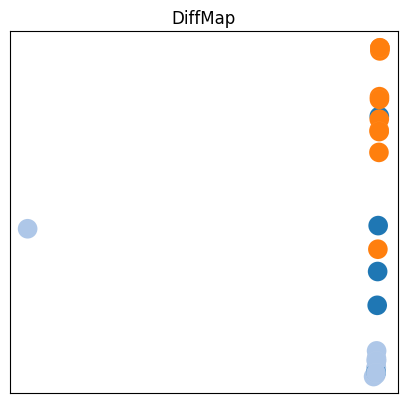

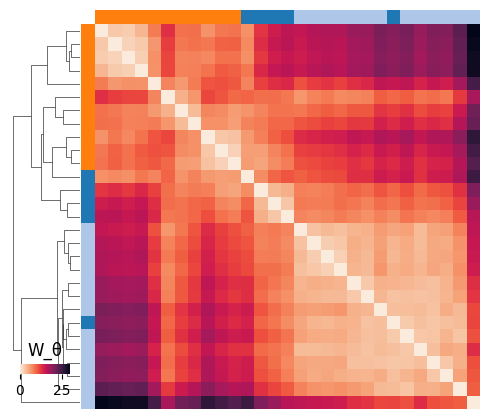

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.93±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.83±0.13
Data myocard_infarct Metric theta_1_10_3_5_iter30_Lfro


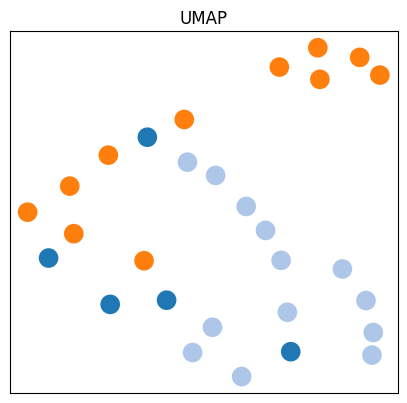

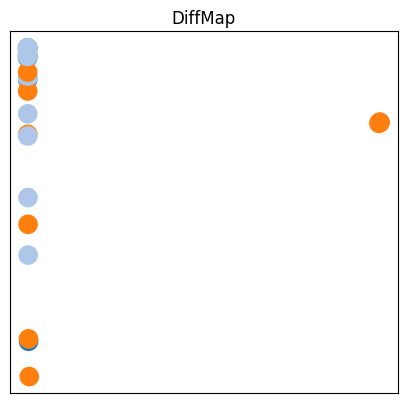

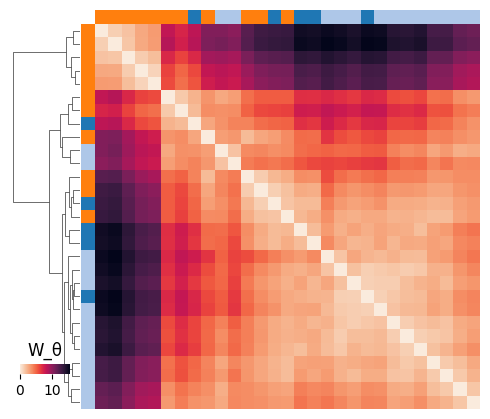

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.78±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.72±0.11
Data myocard_infarct Metric theta_1_100_3_5_iter30_Lfro


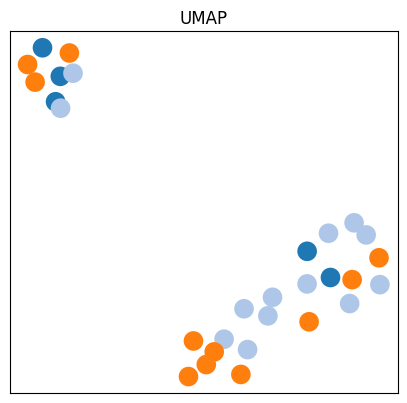

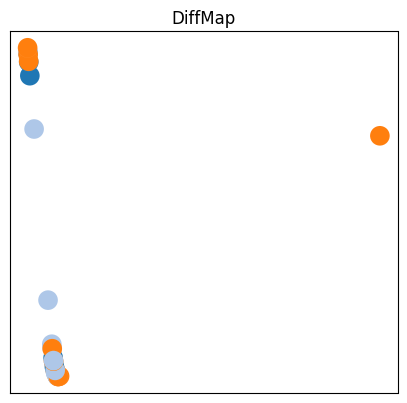

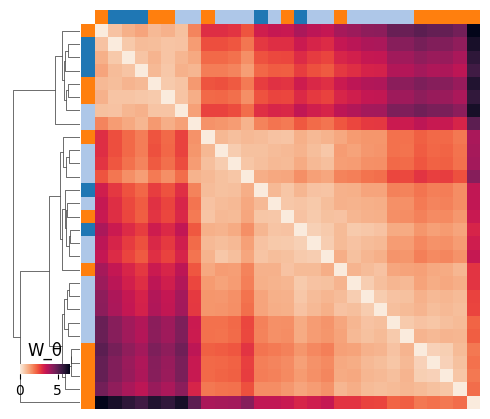

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.56±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.45±0.17
Data myocard_infarct Metric theta_1_1000_3_5_iter30_Lfro


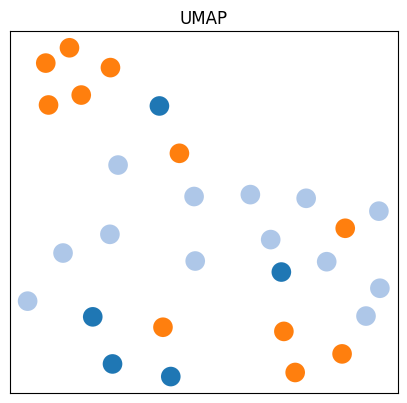

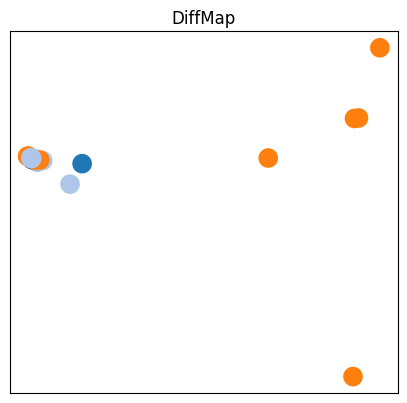

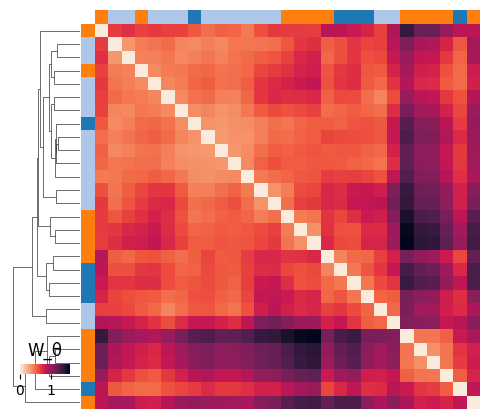

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.56±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.63±0.16
Data myocard_infarct Metric theta_10_0.1_3_5_iter30_Lfro


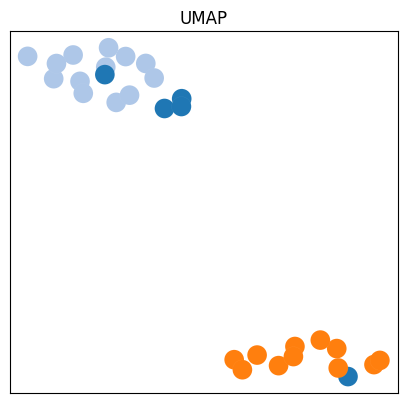

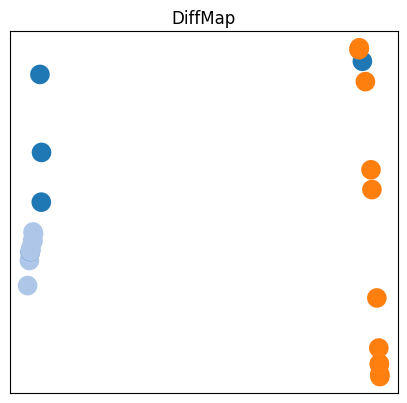

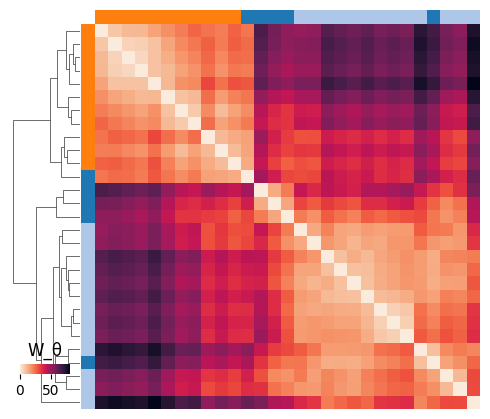

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.91±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.88±0.08
Data myocard_infarct Metric theta_10_1_3_5_iter30_Lfro


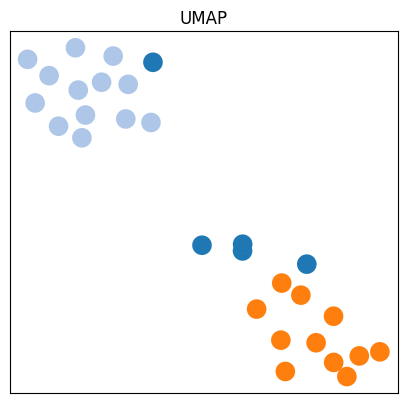

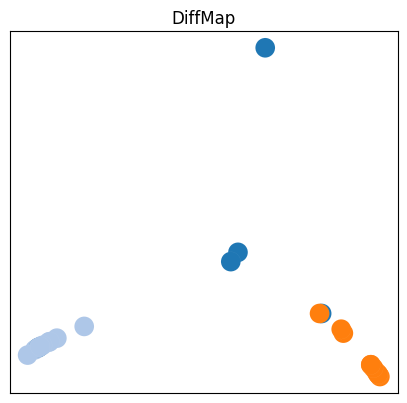

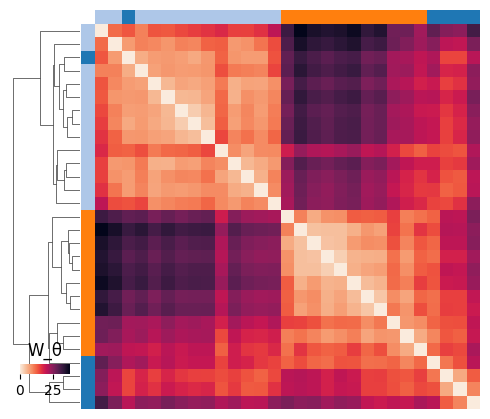

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.94±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.92±0.08
Data myocard_infarct Metric theta_10_10_3_5_iter30_Lfro


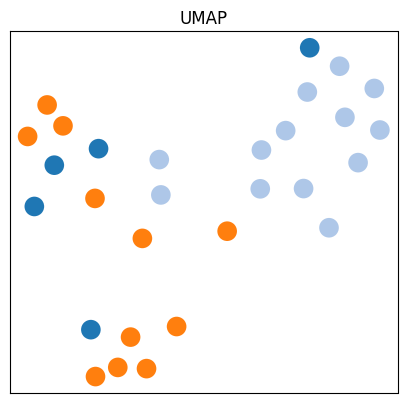

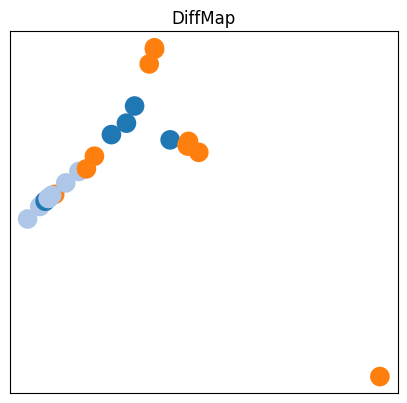

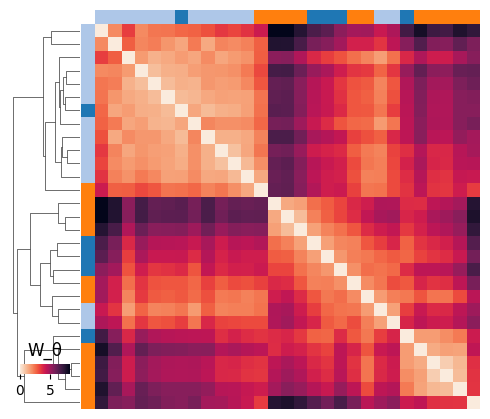

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.78±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.72±0.13
Data myocard_infarct Metric theta_10_100_3_5_iter30_Lfro


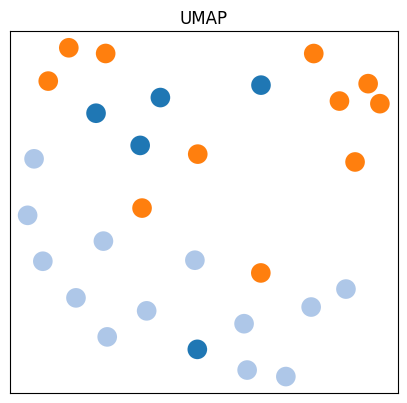

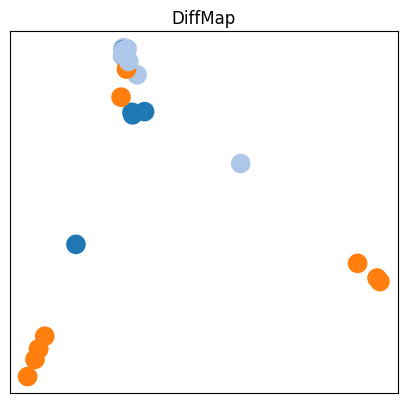

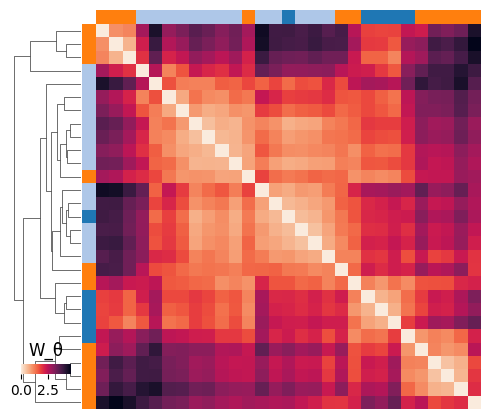

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.72±0.01
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.65±0.05
Data myocard_infarct Metric theta_10_1000_3_5_iter30_Lfro


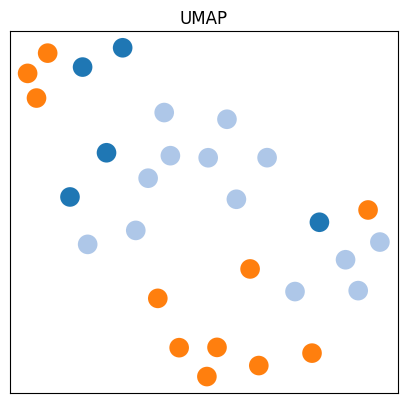

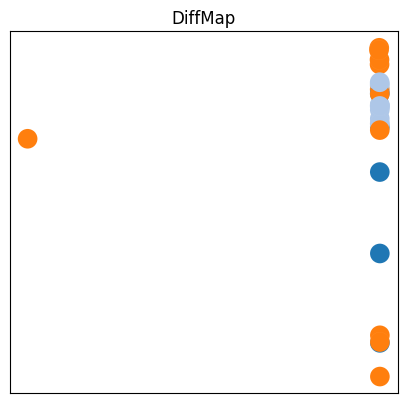

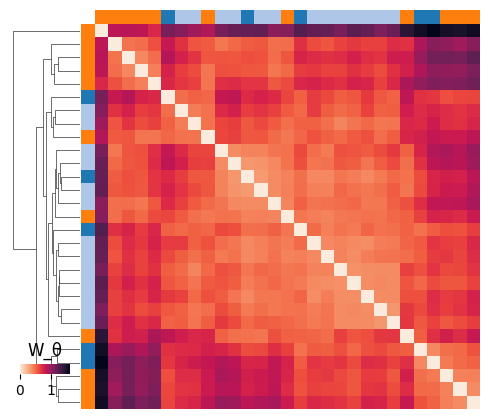

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.53±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.57±0.19
Data myocard_infarct Metric theta_100_0.1_3_5_iter30_Lfro


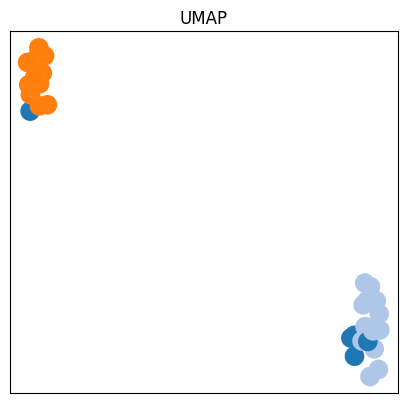

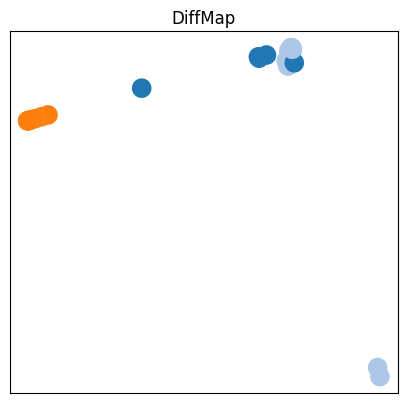

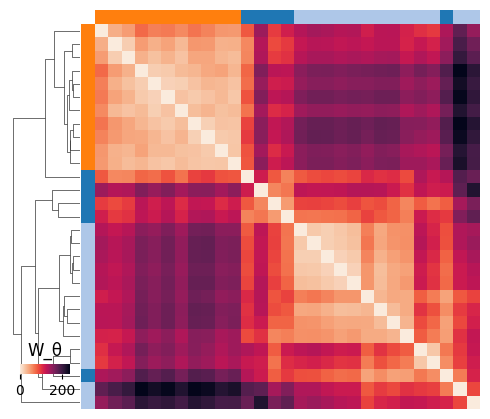

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.90±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.90±0.08
Data myocard_infarct Metric theta_100_1_3_5_iter30_Lfro


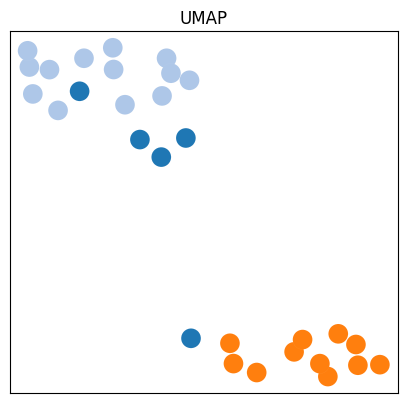

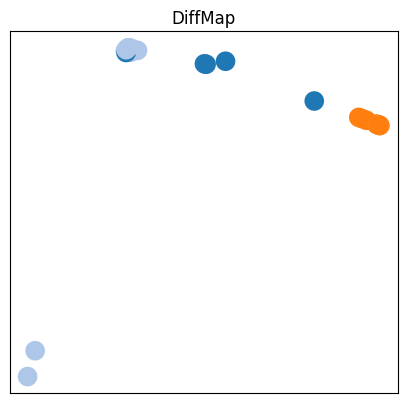

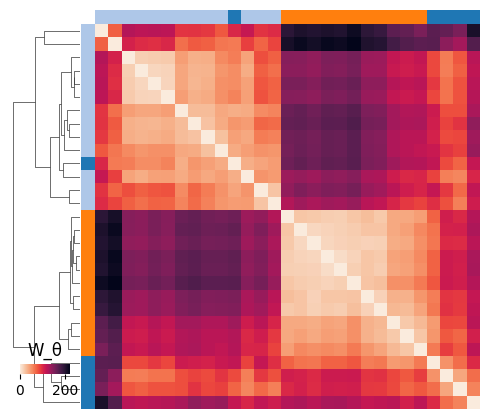

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.90±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.90±0.08
Data myocard_infarct Metric theta_100_10_3_5_iter30_Lfro


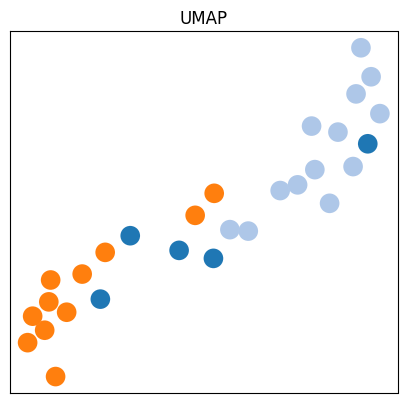

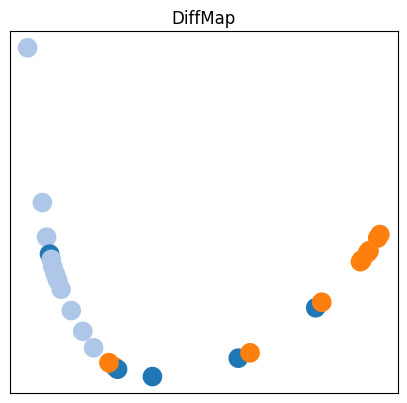

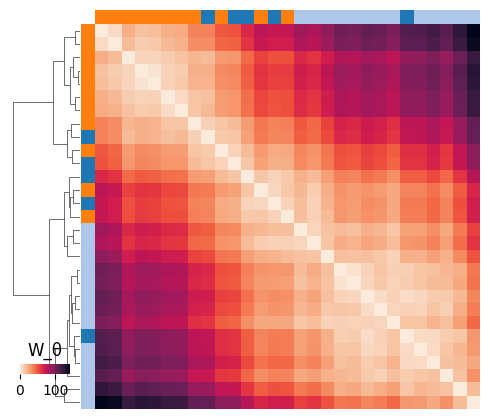

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.77±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.80±0.07
Data myocard_infarct Metric theta_100_100_3_5_iter30_Lfro


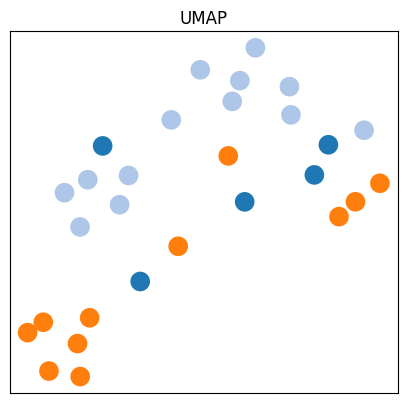

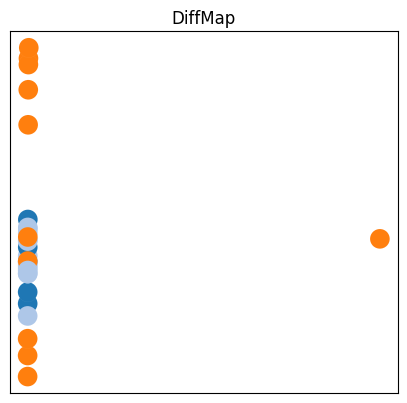

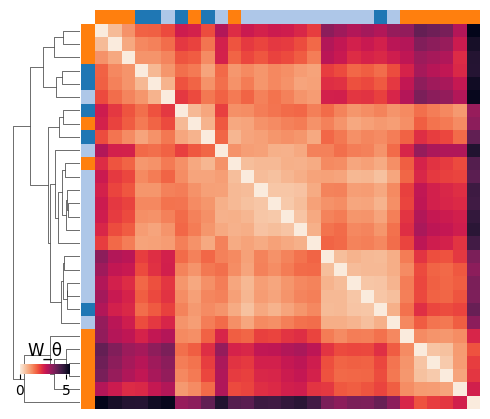

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.69±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.62±0.17
Data myocard_infarct Metric theta_100_1000_3_5_iter30_Lfro


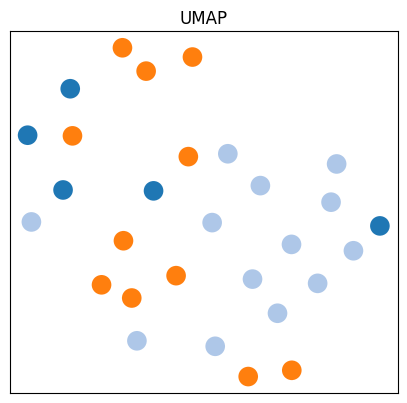

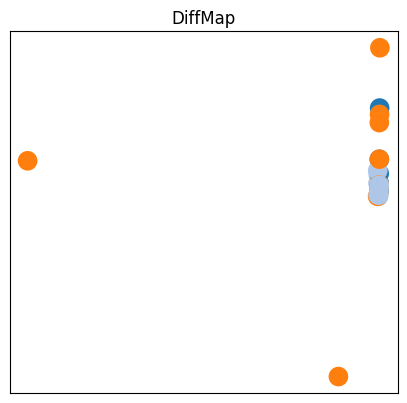

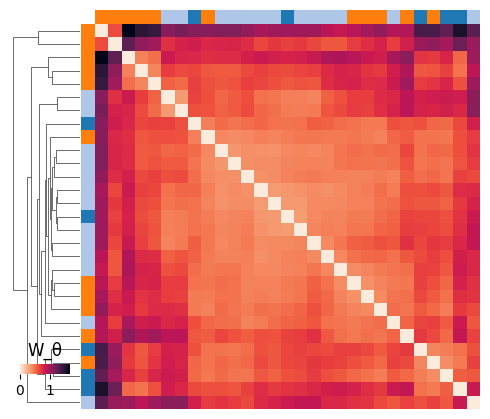

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.52±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.57±0.11
Data myocard_infarct Metric theta_1000_0.1_3_5_iter30_Lfro


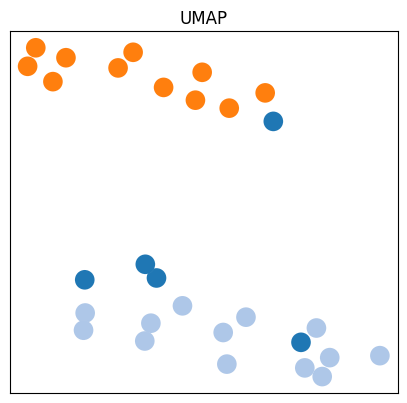

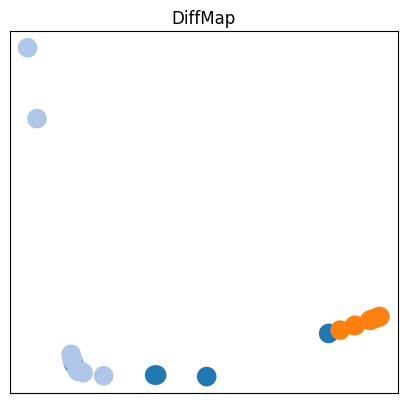

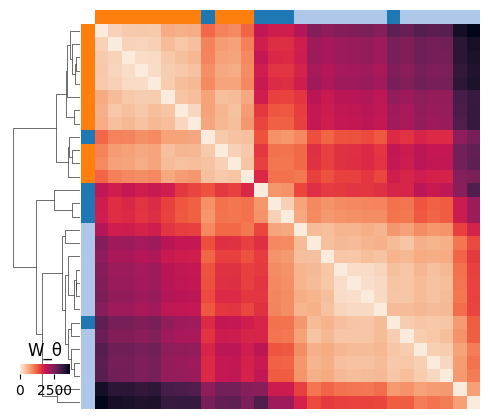

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.88±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.90±0.08
Data myocard_infarct Metric theta_1000_1_3_5_iter30_Lfro


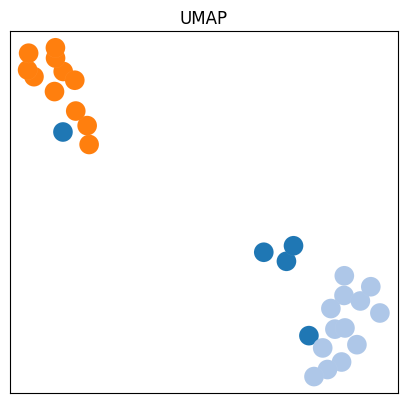

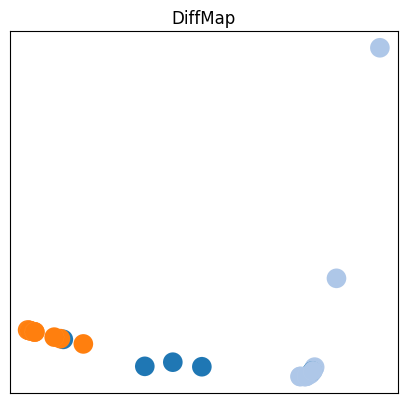

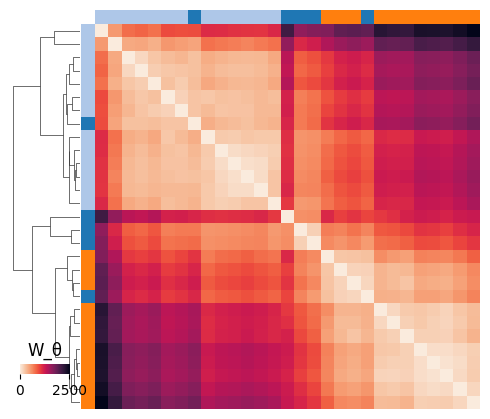

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.88±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.92±0.08
Data myocard_infarct Metric theta_1000_10_3_5_iter30_Lfro


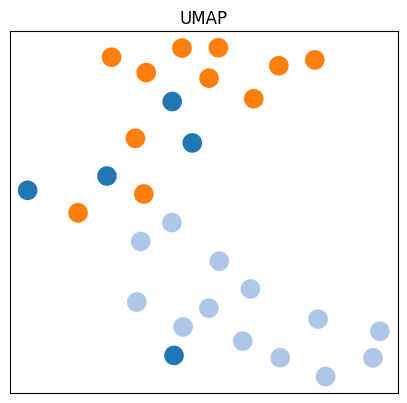

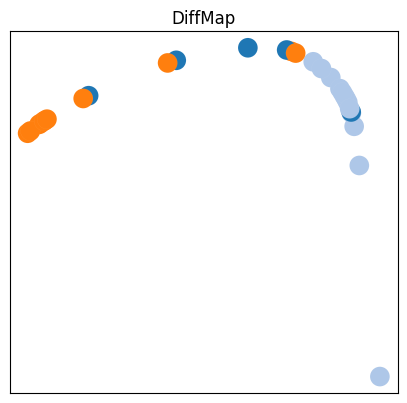

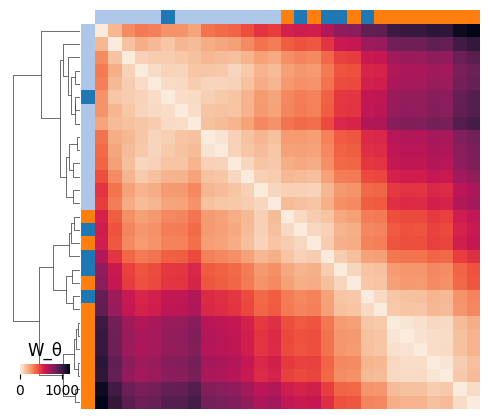

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.74±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.82±0.05
Data myocard_infarct Metric theta_1000_100_3_5_iter30_Lfro


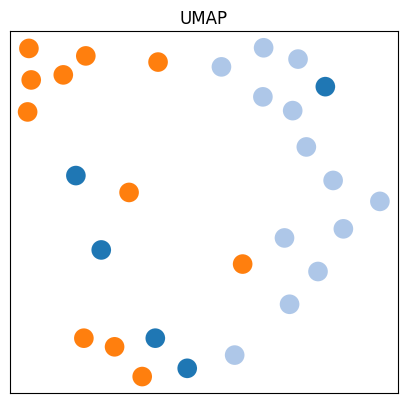

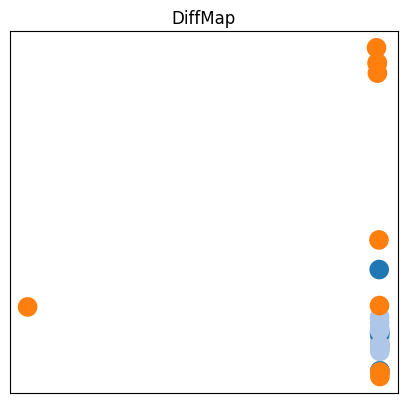

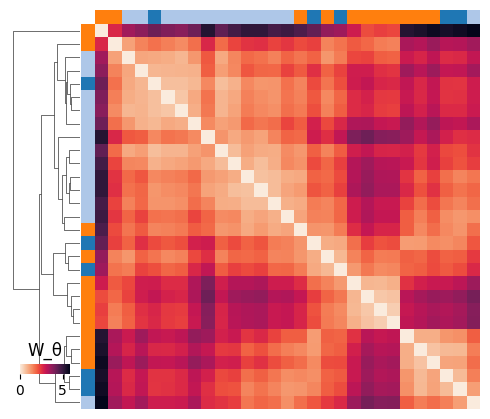

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]


/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


0.70±0.01
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 13  9 24  1 12  6 23 10 15  4]
[18  3 20 19  2  5]
[14 21  7 23 10  2 15  5 27  9 19 26 28 24 12 18 11]
[16 25  1  4 17 20]
[21  8 16  2 11 10 20 22 17  9  7 23 25  4 28 12 15]
[18 14  5  3 19  1]
[ 6 12  0 14  4 22 26  1  8 27 20 10 16  5  9 25 13]
[18  7 21  3 28 15]
[14  1  9 15 24 17 22 19  5 27  6 18  7  4  8  0  3]
[20 13 12 10 21  2]
[18  3 25  6 23 12 20 13 19 11  8  0  5 28  1  7  9]
[24 27  2 21 15 22]
[ 4 20  8 14  0 22  2 26 27 12 16 21 13  6 18  7  3]
[17  5  1 15 25 10]
[16  6 14  9 12 26  0 18 21 13  3  4 25 20 24 19  1]
[10 11 17  7  2 15]
[28 16 27 10  5 11  6 19 20 14 12 15 25 26  1  0  3]
[24 17 22  4  2 13]
0.65±0.14
Data myocard_infarct Metric theta_1000_1000_3_5_iter30_Lfro


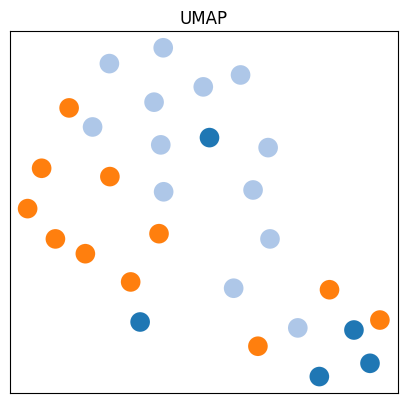

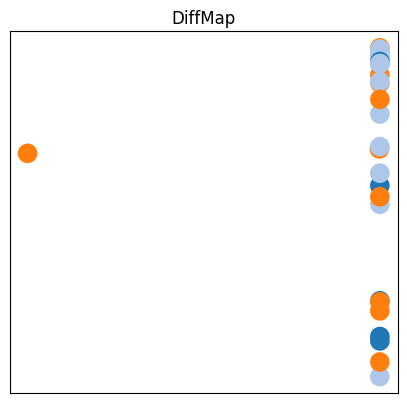

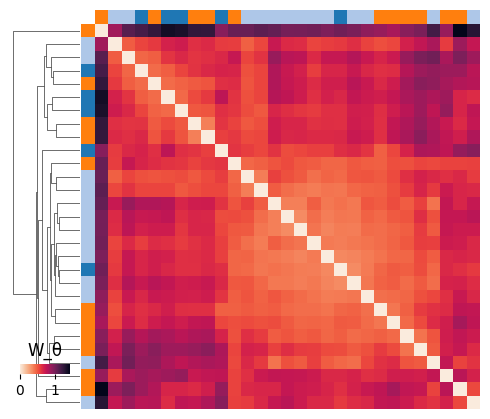

classification
(0,)
(28581,)
[ 5228  3192 25126 ... 16535 16330 21248]
[11741 15772  4398 ... 26700  3311  6280]
[ 9861 26126 23423 ... 23789 21521 18485]
[17142 16879 19395 ... 17757 23348  3843]
[ 7385 15997  2555 ...  9335 16400 10112]
[ 7981 15803 18132 ...  4079  9280 27721]
[16109 19608 23510 ... 17798 13156  8933]
[25190  3405 18678 ... 21964 13431 27024]
[ 4990  3893 21321 ... 12792  9972  7642]
[25247  3247  5824 ... 22756  3612 26777]
[11698  7079 18628 ... 26639 10082  2223]
[21966  5150 10080 ...  6081  9916 23043]
[25957 14553  6114 ...  2071 27706  1947]
[24724 11284 13041 ... 11695  9625 15800]
[18324 17317 23282 ...  2548  3027 13653]
[12689 10633  2624 ... 13840 19823  5833]
[ 2536 25659 21646 ... 11431 11126 14752]
[ 4522 19005  2029 ... 22246 12472 23978]
[ 8955 18115 10922 ... 24204 17859  4368]
[ 5100  7840 10144 ...  5756  3635 12434]
0.52±0.00
classification
(0,)
(29,)
[ 7 28 27  6  1 24  8 22  9  5  3 19  4 21 25 13 12]
[ 2 20 18 26 23 11]
[11  0  8 16 26  7 27 

/tmp/ipykernel_323206/3632313572.py:7: RuntimeWarning: invalid value encountered in divide
  accuracy = prediction[:,0] / np.sum(prediction,axis=-1)


In [13]:
%load_ext autoreload
%autoreload 2

#Classification
import sklearn 
import scipy as sp
from ggml.benchmark import knn_from_dists, plot_table, plot_1split
import pickle

train_size=0.6
test_size =0.2
validation_size= 0.2

for d,data in enumerate(precomputed_ground_distances):
    results[data]={}

    for m, (metric_name, distances) in enumerate(precomputed_ground_distances[data].items()):
        print(f"Data {data} Metric {metric_name}")


        if distances is None:
            results[data][metric_name]=None    
        else:
            
            if True:
            #try:
                points = np.asarray(datasets[data]["points"])
                point_labels = np.asarray(datasets[data]["point_labels"])
                if true_modes_available:
                    points = points[np.asarray(datasets[data]["patient"])==1]
                    point_labels = point_labels[np.asarray(datasets[data]["patient"])==1]
                    print(len(point_labels))
                    #print(len(np.where(np.asarray(datasets[data]["patient"])==1)[0]))
                    mode_ind = np.ix_(np.where(np.asarray(datasets[data]["patient"])==1)[0],np.where(np.asarray(datasets[data]["patient"])==1)[0])

                    element_level = (distances[mode_ind], point_labels)
                    print("computed")
                    #print(distances[mode_ind].shape)
                else:
                    element_level = (distances, point_labels)
                distribution_level = (compute_OT(datasets[data]["distributions"],datasets[data]["distributions_labels"],precomputed_distances=distances,numThreads=n_threads),datasets[data]["distributions_labels"])
            #except Exception as e:
            #    print(e)
            #    results[data][metric_name]=None  

            results[data][metric_name]={"global":{},"ground":{}}
            for l, (distances,labels) in enumerate([element_level,distribution_level]):

                if l==0:
                    neighs = 100
                elif l==1:
                    neighs = 5

                #enforce int labels
                labels = np.unique(labels, return_inverse=True)[1]
    
                
                if True: #try:
                    if classify:
                        print("classification")
                        #Needed for only classifying datapoints that come from distinct modes
                        patient_labels = np.squeeze(np.asarray(datasets[data]["patient"])[np.asarray(datasets[data]["patient"])==1]) #last one hardcoded for synth data, no mdoes known for real world data

                        print(patient_labels.shape)
                        print(labels.shape)
                        #print(distances.shape)

                        pred, true, score, _ , test_indices= knn_from_dists(distances,labels,method=metric_name,weights="uniform",test_size=test_size ,train_size=train_size,n_splits=10,n_neighbors=neighs,distribution_labels= patient_labels if (l==0 and patient_group_split) else None) #'distance' ##, train_indices 
                        result = f"{np.average(score):.2f}±{np.std(score):.2f}"
                        results[data][metric_name]["global" if l==0 else "ground"]["KNN"]=result
                        if l==0:
                            datapoints_over_split[f"{data}_{metric_name}"] = datapoint_acc_over_splits(pred,true,index=test_indices,length=len(labels))

                        print(result)
                    else:
                        results[data][metric_name]["global" if l==0 else "ground"]["KNN"]= None
                else: #except Exception as e:
                    print(e)
                    results[data][metric_name]=None

                try:
                    if cluster:
                        pred_cluster = sklearn.cluster.AgglomerativeClustering(n_clusters=len(np.unique(labels)) if (l==1 or true_modes_available) else None,distance_threshold= None if (l==1 or true_modes_available) else np.quantile(distances[:,:],0.5),metric='precomputed',linkage='average').fit_predict(distances[:,:])
                        mi_score = sklearn.metrics.mutual_info_score(labels,pred_cluster) #
                        ari_score = sklearn.metrics.adjusted_rand_score(labels,pred_cluster) 
                        vi_score,_,_=VI(pred_cluster,labels,torch=False)
                        print(f"{'global' if l==0 else 'ground'} MI:{mi_score:.2f}  ARI:{ari_score:.2f}   SIL:{vi_score:.2f}")
                        results[data][metric_name]['global' if l==0 else 'ground']["MI"]=mi_score
                        results[data][metric_name]['global' if l==0 else 'ground']["ARI"]=ari_score
                        results[data][metric_name]['global' if l==0 else 'ground']["VI"]=vi_score
                        
                except Exception as e:
                    results[data][metric_name]=None
    print(results)   
    with open(f"{results_path}/{'_'.join(datasets.keys())}2.pickle", 'wb') as handle:
        pickle.dump(results, handle, protocol=pickle.HIGHEST_PROTOCOL)
        print(f"{results_path}/{'_'.join(datasets.keys())}2.pickle")




In [14]:
#results[data][metric_name]["global" if l==0 else "ground"]["MI"]
method_col = metrics.keys()

results_ground_cols = {(a,l):[]  for a in alphas for l in lambdas} #: for d in results.keys() for s in next(iter(results[d].values()))["ground"].keys() }
results_global_cols = {(a,l):[]  for a in alphas for l in lambdas}  #{(d,s):[] for d in results.keys() for s in next(iter(results[d].values()))["global"].keys() }




print(results_ground_cols)

for d in results:
    for a in alphas:
        for l in lambdas:
            m = f"theta_{a}_{l}_3_5_iter{iter}_L{norm}"
            
            if m in results[d] and results[d][m] is not None:
                for s in results[d][m]["ground"]:
                    results_ground_cols[(a,l)].append(results[d][m]["ground"][s])
                for s in results[d][m]["global"]:
                    results_global_cols[(a,l)].append(results[d][m]["global"][s]) 
            else:
                #del results_global_cols[(a,l)]
                results_ground_cols[(a,l)].append("--")
                results_global_cols[(a,l)].append("--")
                #del results_ground_cols[(a,l)]

print(results_ground_cols)

#results_ground_cols["method"] = method_col 
#results_global_cols["method"] = method_col 

print(pd.DataFrame(results_ground_cols))

#normal table
for results_cols in [results_ground_cols,results_global_cols]:
#Ground


    table_df = pd.DataFrame(data=results_cols).transpose()

    new_index = lambdas #table_df.index.levels[0]
    new_columns = alphas #table_df.index.levels[1]
    print(lambdas)
    print(alphas)
    table_df  = pd.DataFrame(
        data=[[results_cols[(n,c)][0] for c in new_columns] for n in new_index],
        index=pd.Index(new_index),
        columns=new_columns,
    )

    #table_df = table_df.reset_index(level=1)
    display(table_df)
    print(table_df.to_latex(index=True,
                    #formatters={"name": str.upper},
                    float_format="{:.1f}".format,
    ))


#formated for colormap
for results_cols in [results_ground_cols,results_global_cols]:
#Ground


    table_df = pd.DataFrame(data=results_cols).transpose()

    new_index = lambdas #table_df.index.levels[0]
    new_columns = alphas #table_df.index.levels[1]
    table_cmap_df  = pd.DataFrame(
        data=[[f"\\zz{{{results_cols[(n,c)][0].split('±')[0]}}}" for c in new_columns] for n in new_index],
        index=pd.Index(new_index),
        columns=new_columns,
    )

    #table_df = table_df.reset_index(level=1)
    display(table_cmap_df)
    print(table_cmap_df.to_latex(index=False,
                    #formatters={"name": str.upper},
                    float_format="{:.1f}".format,
    ))
    


{(0.1, 0.1): [], (0.1, 1): [], (0.1, 10): [], (0.1, 100): [], (0.1, 1000): [], (1, 0.1): [], (1, 1): [], (1, 10): [], (1, 100): [], (1, 1000): [], (10, 0.1): [], (10, 1): [], (10, 10): [], (10, 100): [], (10, 1000): [], (100, 0.1): [], (100, 1): [], (100, 10): [], (100, 100): [], (100, 1000): [], (1000, 0.1): [], (1000, 1): [], (1000, 10): [], (1000, 100): [], (1000, 1000): []}
{(0.1, 0.1): ['0.87±0.10'], (0.1, 1): ['0.83±0.11'], (0.1, 10): ['0.75±0.11'], (0.1, 100): ['0.60±0.19'], (0.1, 1000): ['0.65±0.16'], (1, 0.1): ['0.85±0.05'], (1, 1): ['0.83±0.13'], (1, 10): ['0.72±0.11'], (1, 100): ['0.45±0.17'], (1, 1000): ['0.63±0.16'], (10, 0.1): ['0.88±0.08'], (10, 1): ['0.92±0.08'], (10, 10): ['0.72±0.13'], (10, 100): ['0.65±0.05'], (10, 1000): ['0.57±0.19'], (100, 0.1): ['0.90±0.08'], (100, 1): ['0.90±0.08'], (100, 10): ['0.80±0.07'], (100, 100): ['0.62±0.17'], (100, 1000): ['0.57±0.11'], (1000, 0.1): ['0.90±0.08'], (1000, 1): ['0.92±0.08'], (1000, 10): ['0.82±0.05'], (1000, 100): ['0.65±

,0.1,1.0,10.0,100.0,1000.0
0.1,0.87±0.10,0.83±0.11,0.75±0.11,0.60±0.19,0.65±0.16
1.0,0.85±0.05,0.83±0.13,0.72±0.11,0.45±0.17,0.63±0.16
10.0,0.88±0.08,0.92±0.08,0.72±0.13,0.65±0.05,0.57±0.19
100.0,0.90±0.08,0.90±0.08,0.80±0.07,0.62±0.17,0.57±0.11
1000.0,0.90±0.08,0.92±0.08,0.82±0.05,0.65±0.14,0.53±0.21


\begin{tabular}{llllll}
\toprule
 & 0.100000 & 1.000000 & 10.000000 & 100.000000 & 1000.000000 \\
\midrule
0.100000 & 0.87±0.10 & 0.83±0.11 & 0.75±0.11 & 0.60±0.19 & 0.65±0.16 \\
1.000000 & 0.85±0.05 & 0.83±0.13 & 0.72±0.11 & 0.45±0.17 & 0.63±0.16 \\
10.000000 & 0.88±0.08 & 0.92±0.08 & 0.72±0.13 & 0.65±0.05 & 0.57±0.19 \\
100.000000 & 0.90±0.08 & 0.90±0.08 & 0.80±0.07 & 0.62±0.17 & 0.57±0.11 \\
1000.000000 & 0.90±0.08 & 0.92±0.08 & 0.82±0.05 & 0.65±0.14 & 0.53±0.21 \\
\bottomrule
\end{tabular}

[0.1, 1, 10, 100, 1000]
[0.1, 1, 10, 100, 1000]


,0.1,1.0,10.0,100.0,1000.0
0.1,0.92±0.00,0.87±0.00,0.79±0.00,0.64±0.00,0.66±0.00
1.0,0.92±0.00,0.93±0.00,0.78±0.00,0.56±0.00,0.56±0.00
10.0,0.91±0.00,0.94±0.00,0.78±0.00,0.72±0.01,0.53±0.00
100.0,0.90±0.00,0.90±0.00,0.77±0.00,0.69±0.00,0.52±0.00
1000.0,0.88±0.00,0.88±0.00,0.74±0.00,0.70±0.01,0.52±0.00


\begin{tabular}{llllll}
\toprule
 & 0.100000 & 1.000000 & 10.000000 & 100.000000 & 1000.000000 \\
\midrule
0.100000 & 0.92±0.00 & 0.87±0.00 & 0.79±0.00 & 0.64±0.00 & 0.66±0.00 \\
1.000000 & 0.92±0.00 & 0.93±0.00 & 0.78±0.00 & 0.56±0.00 & 0.56±0.00 \\
10.000000 & 0.91±0.00 & 0.94±0.00 & 0.78±0.00 & 0.72±0.01 & 0.53±0.00 \\
100.000000 & 0.90±0.00 & 0.90±0.00 & 0.77±0.00 & 0.69±0.00 & 0.52±0.00 \\
1000.000000 & 0.88±0.00 & 0.88±0.00 & 0.74±0.00 & 0.70±0.01 & 0.52±0.00 \\
\bottomrule
\end{tabular}



,0.1,1.0,10.0,100.0,1000.0
0.1,\zz{0.87},\zz{0.83},\zz{0.75},\zz{0.60},\zz{0.65}
1.0,\zz{0.85},\zz{0.83},\zz{0.72},\zz{0.45},\zz{0.63}
10.0,\zz{0.88},\zz{0.92},\zz{0.72},\zz{0.65},\zz{0.57}
100.0,\zz{0.90},\zz{0.90},\zz{0.80},\zz{0.62},\zz{0.57}
1000.0,\zz{0.90},\zz{0.92},\zz{0.82},\zz{0.65},\zz{0.53}


\begin{tabular}{lllll}
\toprule
0.100000 & 1.000000 & 10.000000 & 100.000000 & 1000.000000 \\
\midrule
\zz{0.87} & \zz{0.83} & \zz{0.75} & \zz{0.60} & \zz{0.65} \\
\zz{0.85} & \zz{0.83} & \zz{0.72} & \zz{0.45} & \zz{0.63} \\
\zz{0.88} & \zz{0.92} & \zz{0.72} & \zz{0.65} & \zz{0.57} \\
\zz{0.90} & \zz{0.90} & \zz{0.80} & \zz{0.62} & \zz{0.57} \\
\zz{0.90} & \zz{0.92} & \zz{0.82} & \zz{0.65} & \zz{0.53} \\
\bottomrule
\end{tabular}



,0.1,1.0,10.0,100.0,1000.0
0.1,\zz{0.92},\zz{0.87},\zz{0.79},\zz{0.64},\zz{0.66}
1.0,\zz{0.92},\zz{0.93},\zz{0.78},\zz{0.56},\zz{0.56}
10.0,\zz{0.91},\zz{0.94},\zz{0.78},\zz{0.72},\zz{0.53}
100.0,\zz{0.90},\zz{0.90},\zz{0.77},\zz{0.69},\zz{0.52}
1000.0,\zz{0.88},\zz{0.88},\zz{0.74},\zz{0.70},\zz{0.52}


\begin{tabular}{lllll}
\toprule
0.100000 & 1.000000 & 10.000000 & 100.000000 & 1000.000000 \\
\midrule
\zz{0.92} & \zz{0.87} & \zz{0.79} & \zz{0.64} & \zz{0.66} \\
\zz{0.92} & \zz{0.93} & \zz{0.78} & \zz{0.56} & \zz{0.56} \\
\zz{0.91} & \zz{0.94} & \zz{0.78} & \zz{0.72} & \zz{0.53} \\
\zz{0.90} & \zz{0.90} & \zz{0.77} & \zz{0.69} & \zz{0.52} \\
\zz{0.88} & \zz{0.88} & \zz{0.74} & \zz{0.70} & \zz{0.52} \\
\bottomrule
\end{tabular}



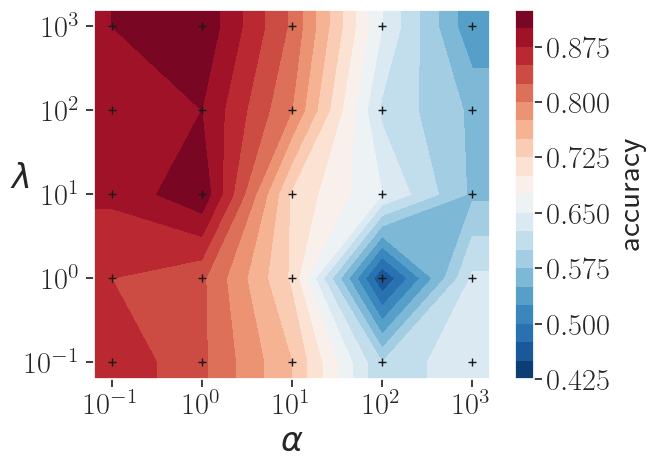

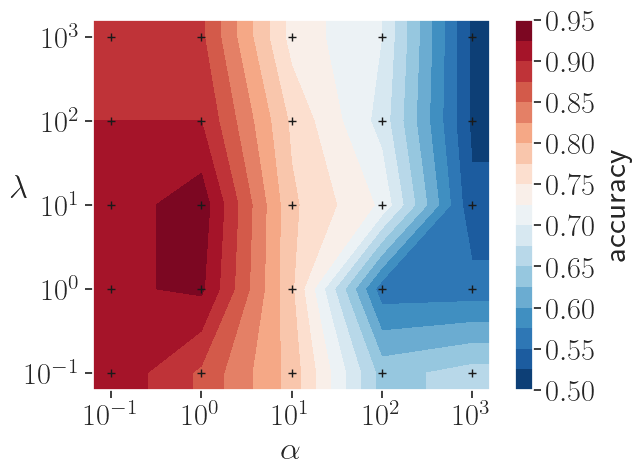

In [15]:
from matplotlib import ticker
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

sns.set(font_scale=2)
for i,results_cols in enumerate([results_ground_cols,results_global_cols]):
#Ground


    table_df = pd.DataFrame(data=results_cols).transpose()
    ###
    lambdas_ =  []
    alphas_ = []
    values_ = []
    for l in lambdas: 
        for a in alphas:
            lambdas_.append(l)
            alphas_.append(a)
            values_.append(results_cols[(l, a)][0].split('±')[0])
    wide_df = pd.DataFrame({"alpha":alphas_,"lambda":lambdas_,"values":values_}).replace("--",0.00).astype("f")
    ##

    #pad for contour borders
    new_index = lambdas    #table_df.index.levels[0]
    new_columns = alphas #table_df.index.levels[1]
    table_cmap_df  = pd.DataFrame(
        data=[[f"{results_cols[(n, c)][0].split('±')[0]}" if (n, c) in results_cols else 0 for c in new_columns] for n in new_index],
        index=pd.Index(new_index),
        columns=new_columns,
    )
    table_cmap_df = table_cmap_df.replace("--",0.00).astype("f")

    def pad_m(m):
        if isinstance(m,list):
            #pad coordinates o 10 log scale
            return [m[0]/10] + alphas + [m[-1]*10]
        else:
            return np.pad(m, ((1,1),(1,1)), 'edge')

    fig, ax = plt.subplots()
    ax.plot(np.log10(alphas_),np.log10(lambdas_), "+k")
    cntr = plt.contourf(np.log10(pad_m(new_columns)),np.log10(pad_m(new_index)),pad_m(table_cmap_df.to_numpy()), levels=20, cmap="RdBu_r",corner_mask=True)
    plt.xlim(-1.2,3.2)
    plt.ylim(-1.2,3.2)
    ax.set_xticks(np.log10(alphas))
    ax.set_xticklabels(alphas)
    ax.set_yticks(np.log10(lambdas))
    ax.set_yticklabels(lambdas)
    for axis in [ax.xaxis, ax.yaxis]:
        #formatter.set_scientific(False)
        
        axis.set_major_formatter(ticker.FuncFormatter(lambda y, _: r'$10^{{{:g}}}$'.format(y)))


    plt.rcParams['text.usetex'] = True
    ax.set_ylabel(r"$\lambda$",rotation=0)
    ax.set_xlabel(r"$\alpha$")
    ax.tick_params(axis=u'both', which=u'both',reset=True,right=False,top=False)
    fig.colorbar(cntr, ax=ax, label="accuracy")

    dataset_name="myocard_infarct_full"
    plot_path = f"/home/kuehn/ot_metric_learning/damin-ggml/data/plots/{dataset_name}"
    plt.savefig(plot_path+f"/hyperparams_{'ground' if i == 0 else 'global'}.pdf")

    plt.show()
    '''
    print(wide_df)

    plt.figure()

    cmap = sns.color_palette("light:b", as_cmap=True) #"vlag_r"
    sns.heatmap(table_cmap_df,cmap=cmap, annot=True, fmt=".2f",cbar=False)
    plt.figure()
    sns.kdeplot(
    data=wide_df,  x="alpha",y="lambda",log_scale=10,weights="values",levels=5,fill=True
    )
    plt.xlim(10**-1.2,10**3.2)
    plt.ylim(10**-1.2,10**3.2)

    plt.show()
    #table_df = table_df.reset_index(level=1)
    display(table_cmap_df)
    print(table_cmap_df.to_latex(index=True,
                    #formatters={"name": str.upper},
                    float_format="{:.1f}".format,
    ))
    

    '''

In [16]:
with open("/home/kuehn/ot_metric_learning/damin-ggml/data/plots/myocard_hyper_ground_results.csv", 'wb') as handle:
        pickle.dump(results_ground_cols, handle, protocol=pickle.HIGHEST_PROTOCOL)
with open("/home/kuehn/ot_metric_learning/damin-ggml/data/plots/myocard_hyper_global_results.csv", 'wb') as handle:
        pickle.dump(results_global_cols, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [17]:
with open("/home/kuehn/ot_metric_learning/damin-ggml/data/plots/myocard_hyper_ground_results.csv", 'rb') as handle:
        results_ground_cols = pickle.load(handle)
with open("/home/kuehn/ot_metric_learning/damin-ggml/data/plots/myocard_hyper_global_results.csv", 'rb') as handle:
        results_global_cols = pickle.load(handle)


print(results_global_cols)

{(0.1, 0.1): ['0.92±0.00'], (0.1, 1): ['0.87±0.00'], (0.1, 10): ['0.79±0.00'], (0.1, 100): ['0.64±0.00'], (0.1, 1000): ['0.66±0.00'], (1, 0.1): ['0.92±0.00'], (1, 1): ['0.93±0.00'], (1, 10): ['0.78±0.00'], (1, 100): ['0.56±0.00'], (1, 1000): ['0.56±0.00'], (10, 0.1): ['0.91±0.00'], (10, 1): ['0.94±0.00'], (10, 10): ['0.78±0.00'], (10, 100): ['0.72±0.01'], (10, 1000): ['0.53±0.00'], (100, 0.1): ['0.90±0.00'], (100, 1): ['0.90±0.00'], (100, 10): ['0.77±0.00'], (100, 100): ['0.69±0.00'], (100, 1000): ['0.52±0.00'], (1000, 0.1): ['0.88±0.00'], (1000, 1): ['0.88±0.00'], (1000, 10): ['0.74±0.00'], (1000, 100): ['0.70±0.01'], (1000, 1000): ['0.52±0.00']}


In [18]:

'''
#Global
table_df = pd.DataFrame(data=results_global_cols).transpose()
display(table_df)
print(table_df.to_latex(index=True,
                #formatters={"name": str.upper},
                float_format="{:.1f}".format,
))
'''

'\n#Global\ntable_df = pd.DataFrame(data=results_global_cols).transpose()\ndisplay(table_df)\nprint(table_df.to_latex(index=True,\n                #formatters={"name": str.upper},\n                float_format="{:.1f}".format,\n))\n'

dict_keys(['myocard_infarct_theta_0.1_0.1_3_5_iter30_Lfro', 'myocard_infarct_theta_0.1_1_3_5_iter30_Lfro', 'myocard_infarct_theta_0.1_10_3_5_iter30_Lfro', 'myocard_infarct_theta_0.1_100_3_5_iter30_Lfro', 'myocard_infarct_theta_0.1_1000_3_5_iter30_Lfro', 'myocard_infarct_theta_1_0.1_3_5_iter30_Lfro', 'myocard_infarct_theta_1_1_3_5_iter30_Lfro', 'myocard_infarct_theta_1_10_3_5_iter30_Lfro', 'myocard_infarct_theta_1_100_3_5_iter30_Lfro', 'myocard_infarct_theta_1_1000_3_5_iter30_Lfro', 'myocard_infarct_theta_10_0.1_3_5_iter30_Lfro', 'myocard_infarct_theta_10_1_3_5_iter30_Lfro', 'myocard_infarct_theta_10_10_3_5_iter30_Lfro', 'myocard_infarct_theta_10_100_3_5_iter30_Lfro', 'myocard_infarct_theta_10_1000_3_5_iter30_Lfro', 'myocard_infarct_theta_100_0.1_3_5_iter30_Lfro', 'myocard_infarct_theta_100_1_3_5_iter30_Lfro', 'myocard_infarct_theta_100_10_3_5_iter30_Lfro', 'myocard_infarct_theta_100_100_3_5_iter30_Lfro', 'myocard_infarct_theta_100_1000_3_5_iter30_Lfro', 'myocard_infarct_theta_1000_0.1_

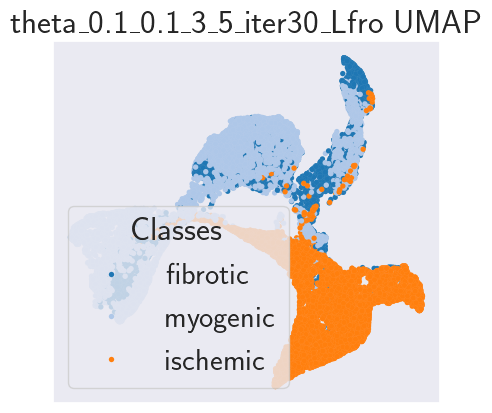

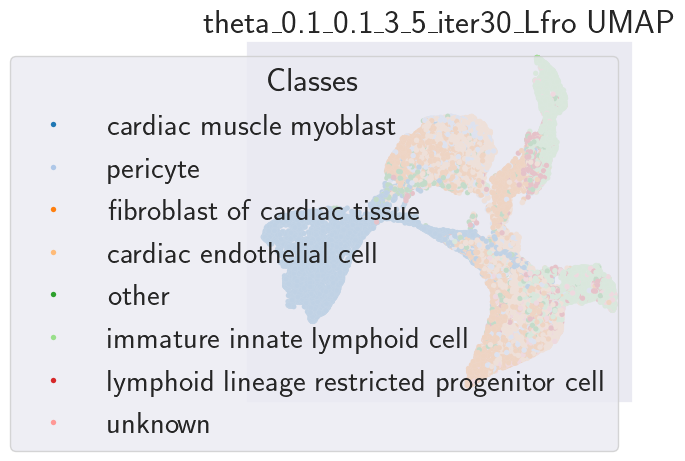

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

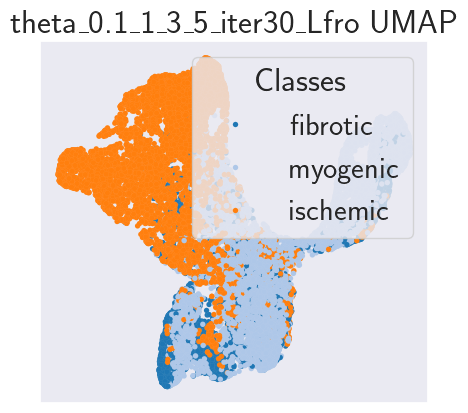

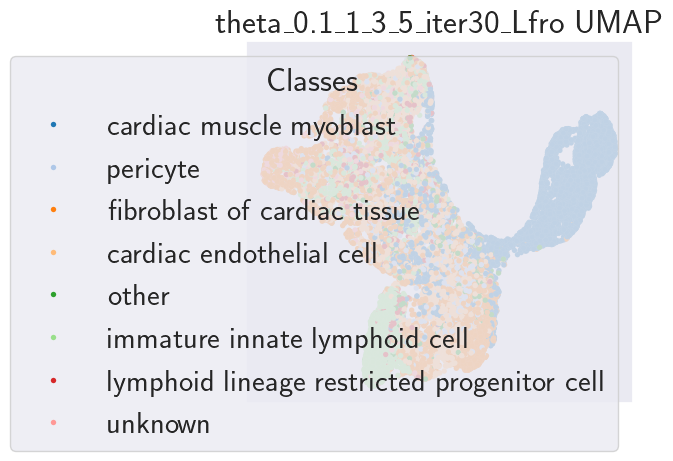

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

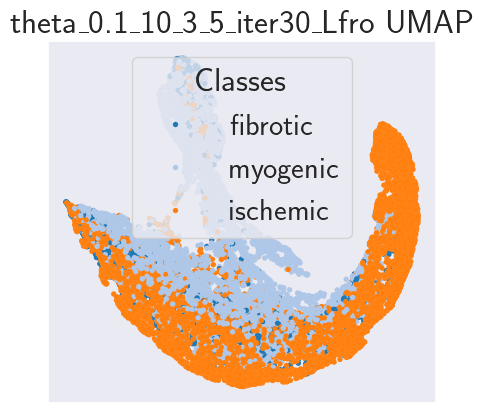

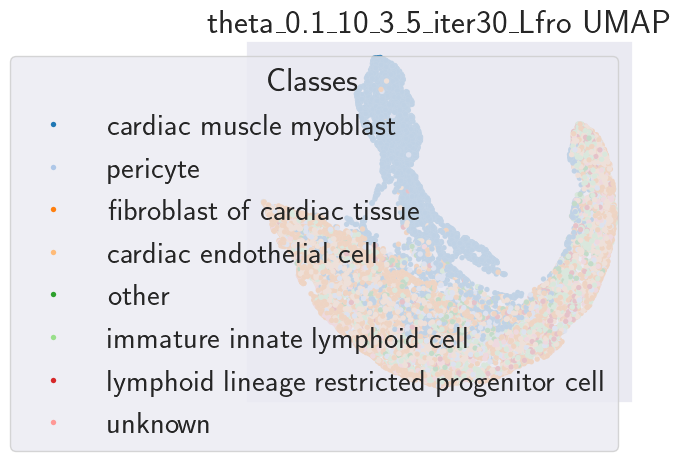

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

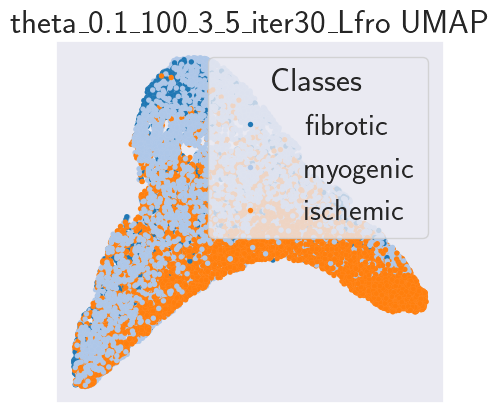

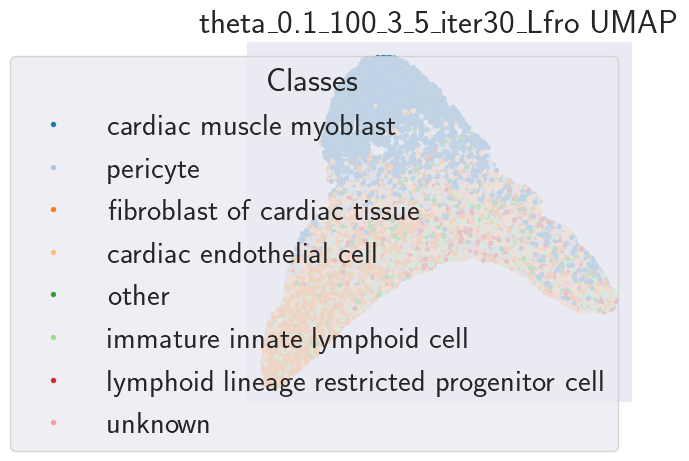

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

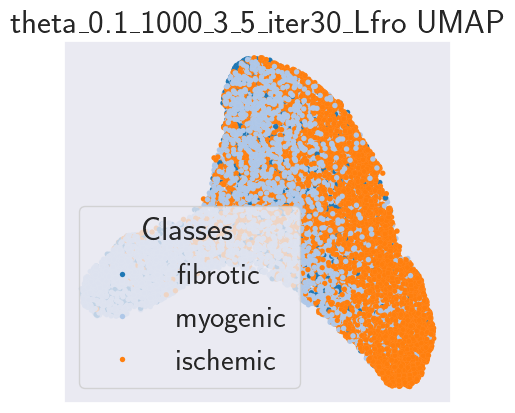

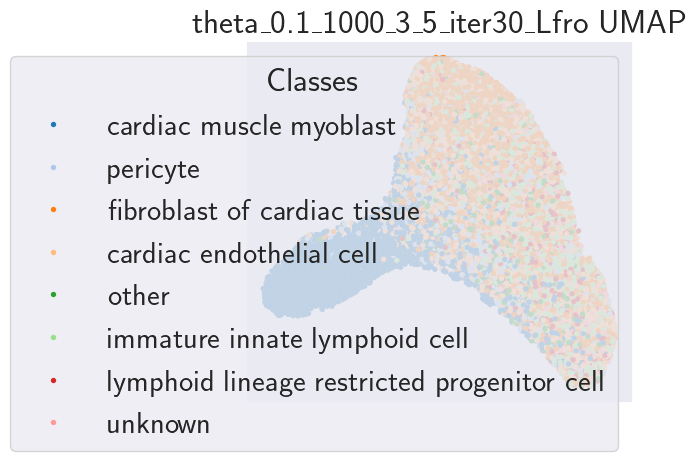

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

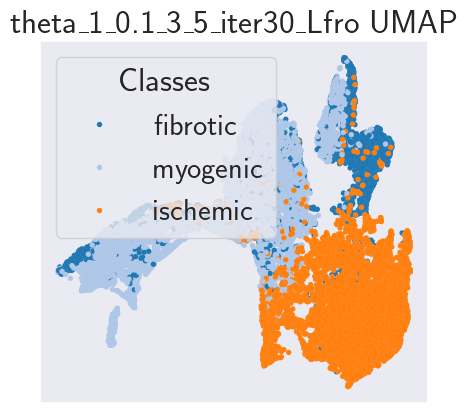

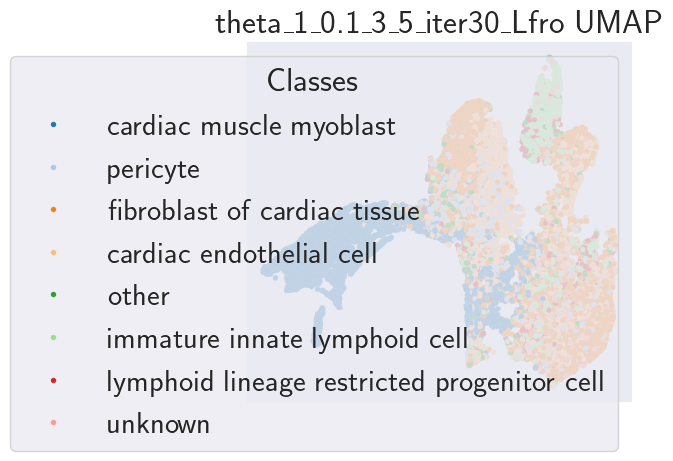

[ 0. nan  1. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

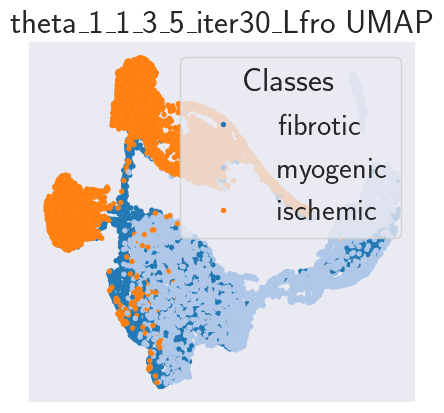

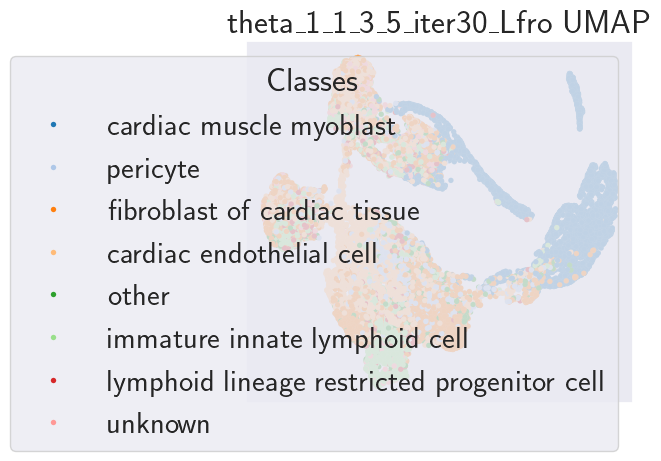

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

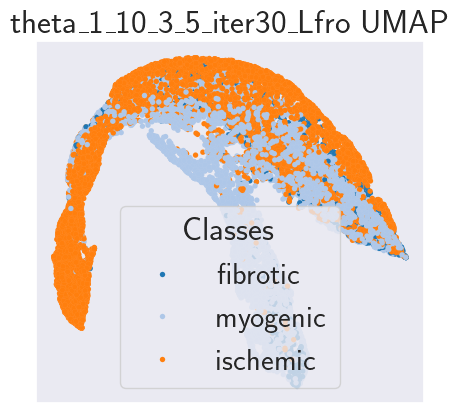

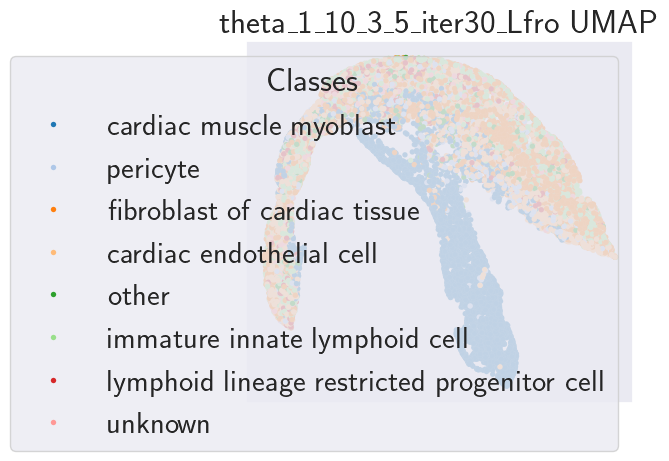

[ 0. nan  0. ...  1.  0.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

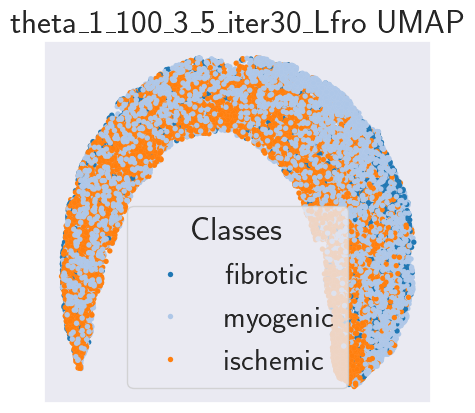

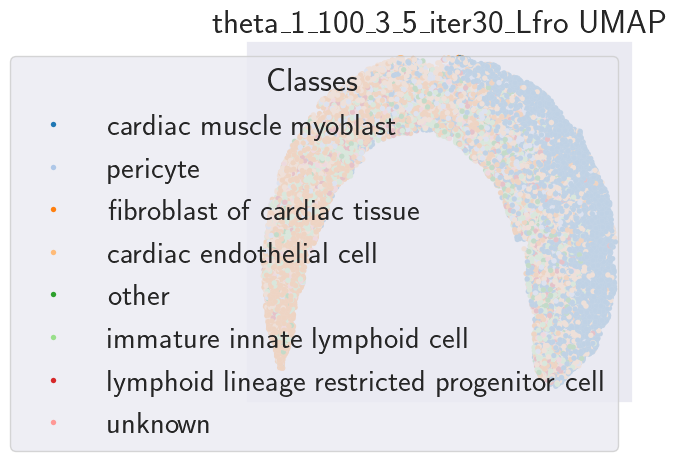

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

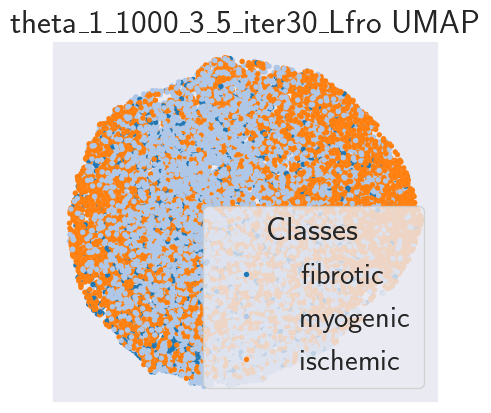

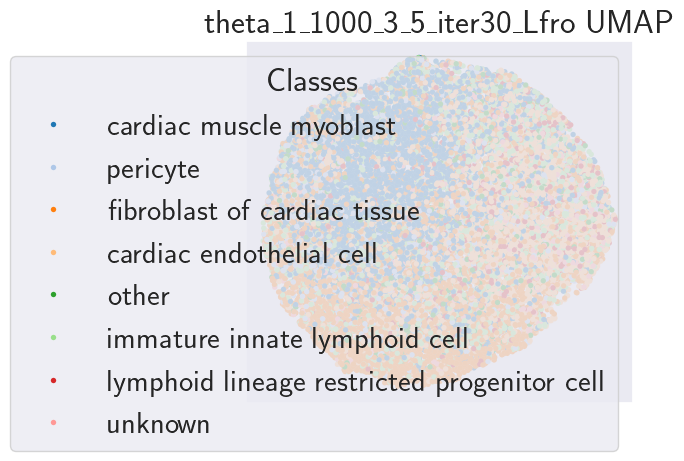

[ 0. nan  1. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

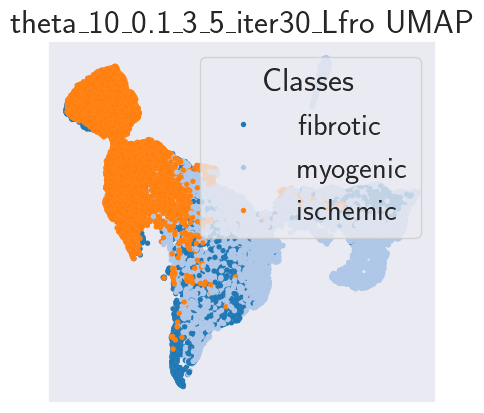

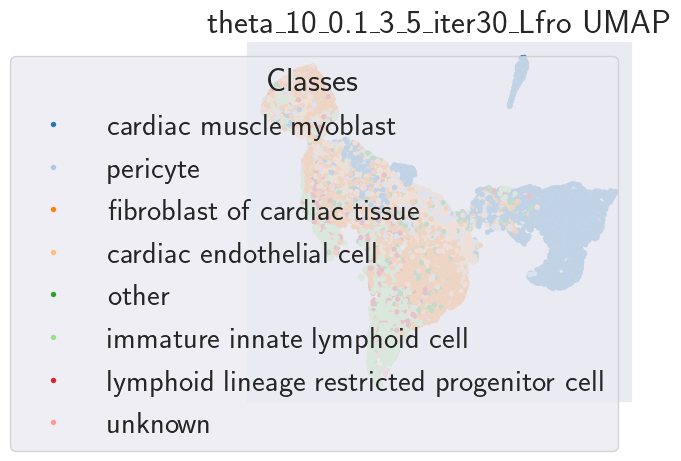

[ 0. nan  1. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

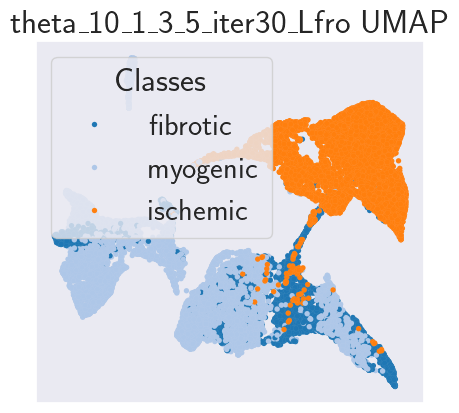

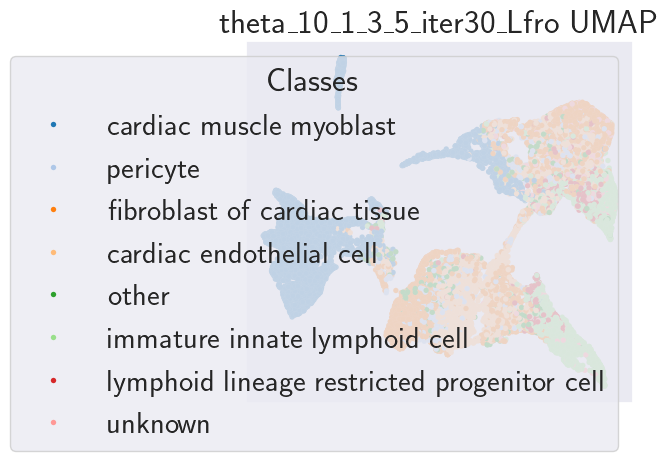

[0.                nan 0.66666667 ... 1.         1.         1.        ]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fib

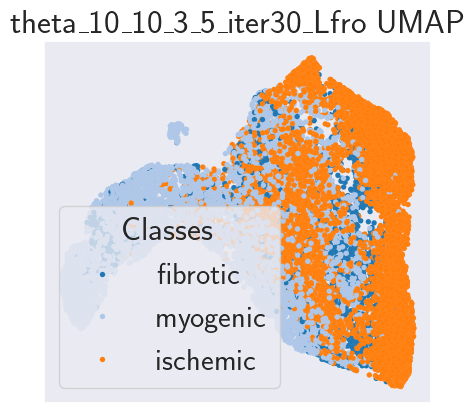

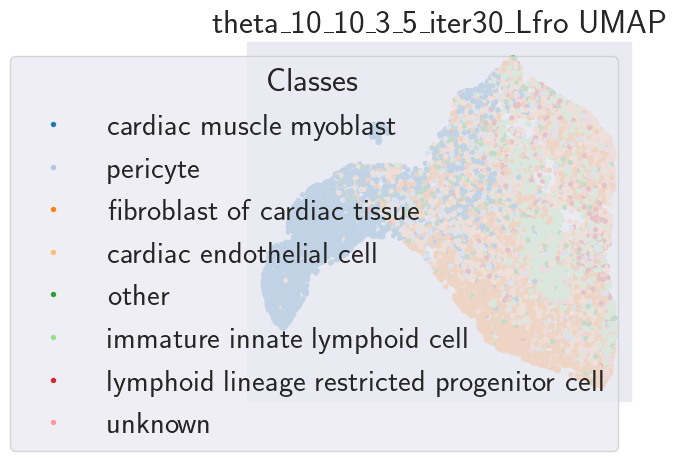

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

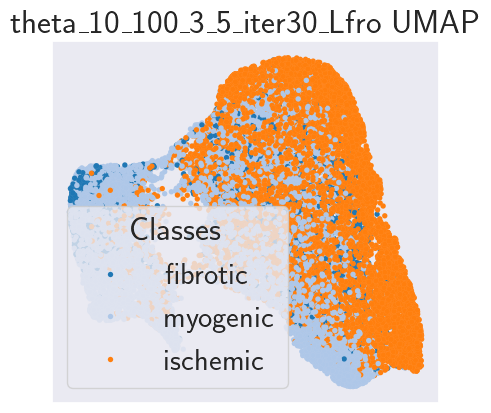

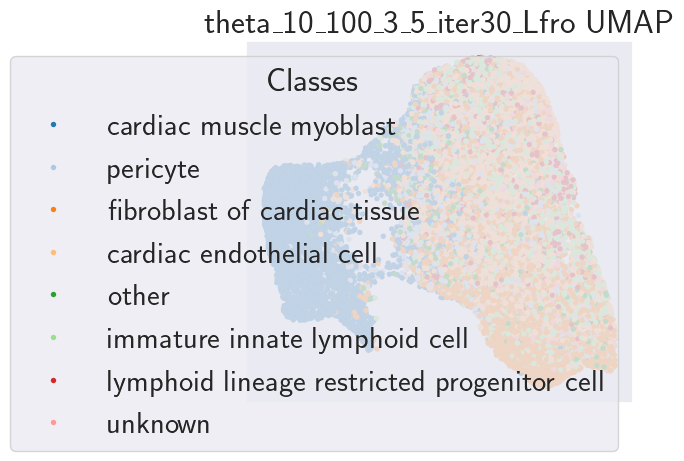

[0.                nan 0.         ... 1.         0.66666667 1.        ]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fib

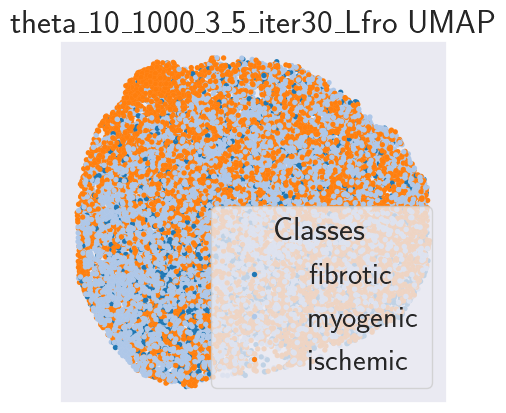

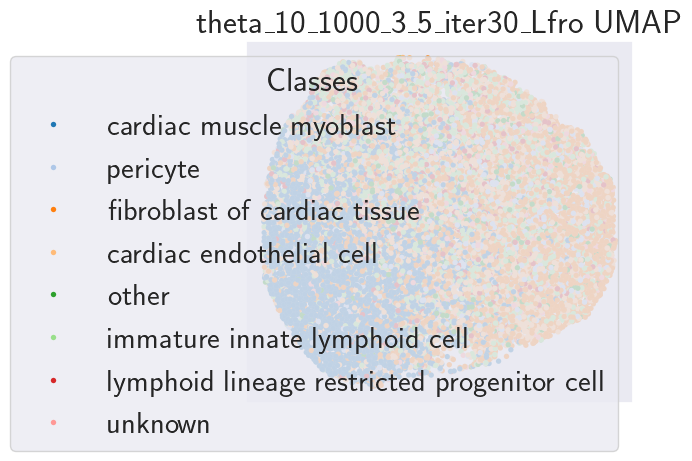

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

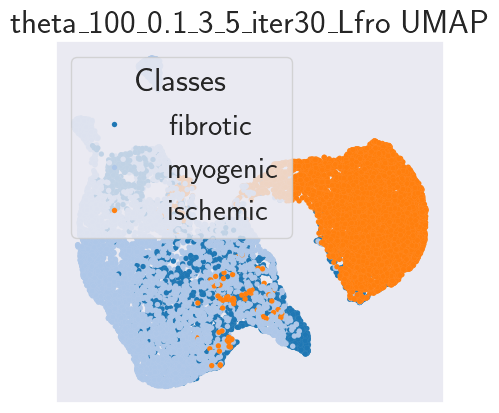

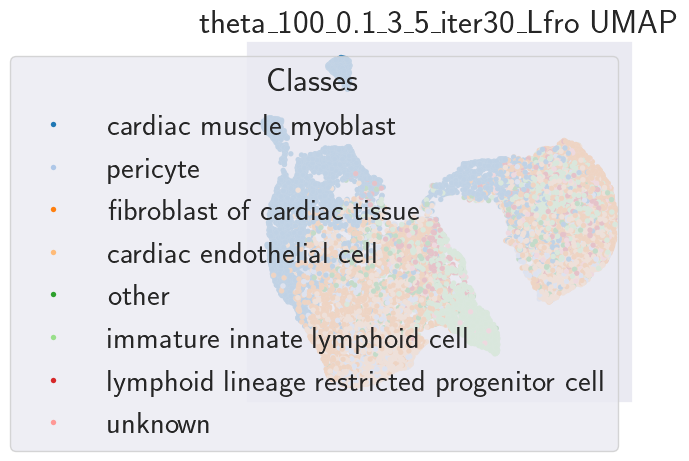

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

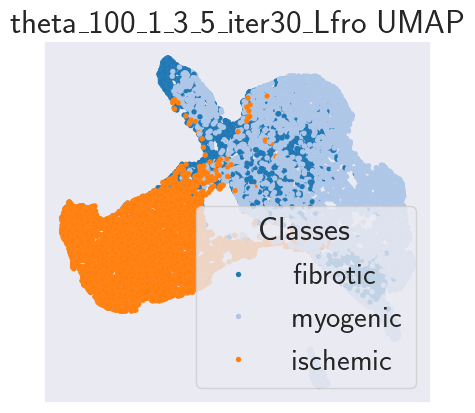

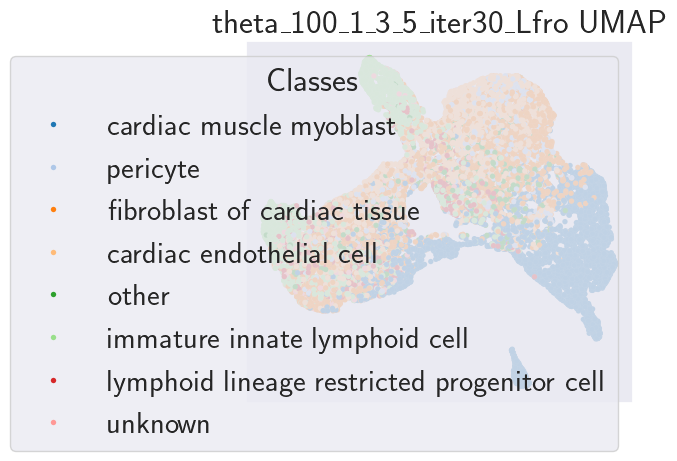

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

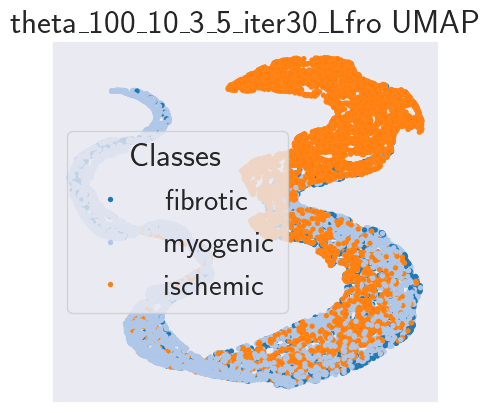

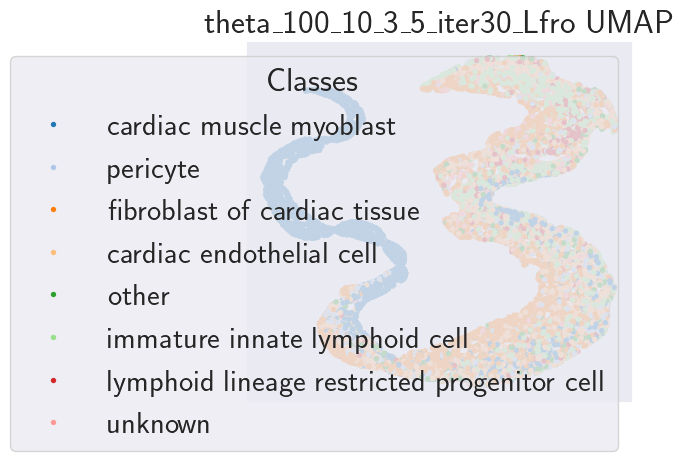

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

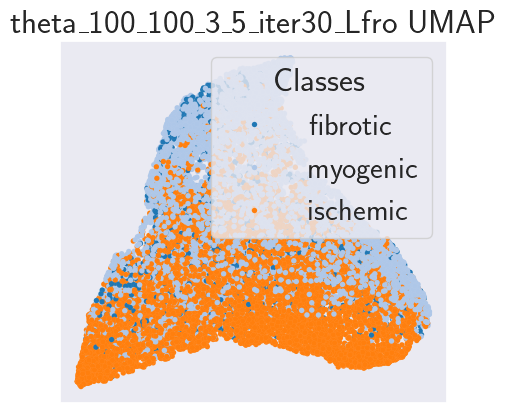

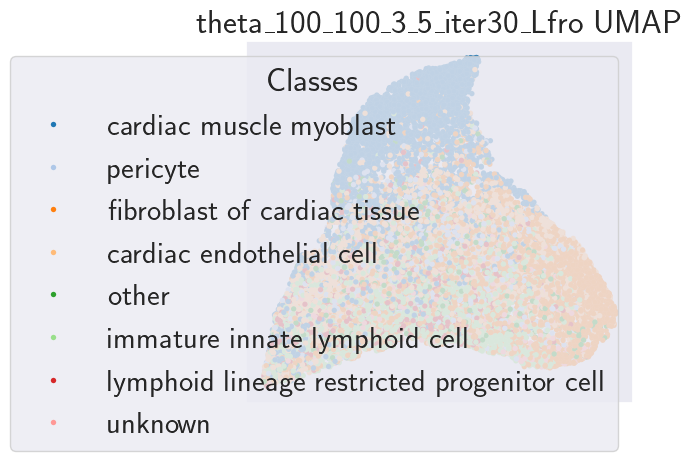

[ 0. nan  0. ...  1.  0.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

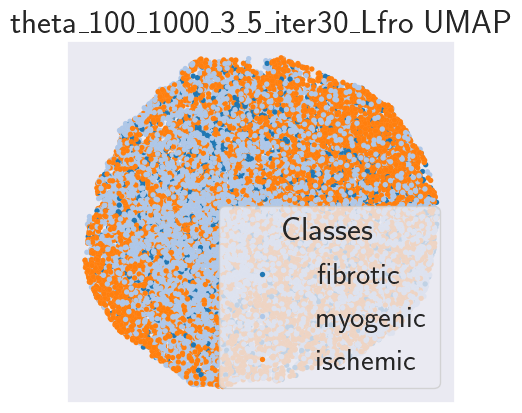

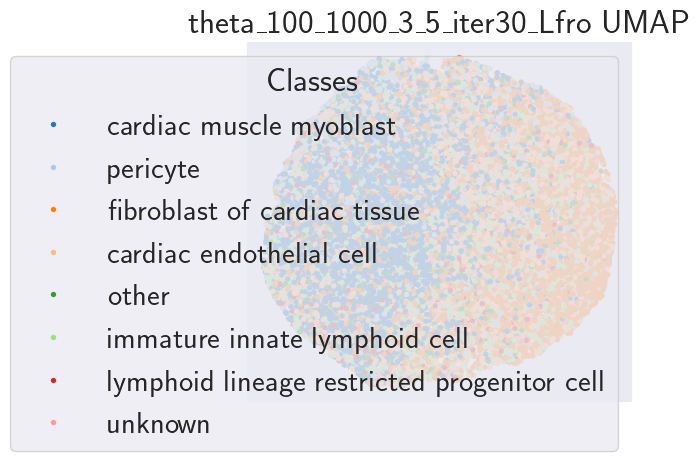

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

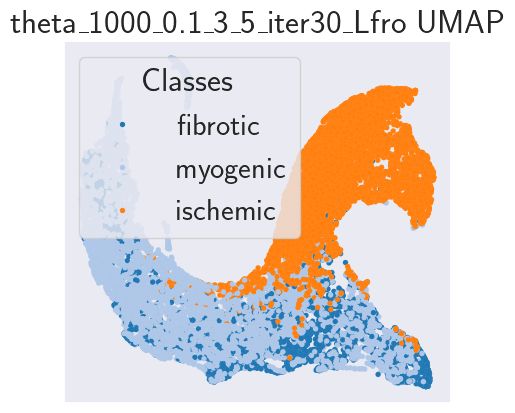

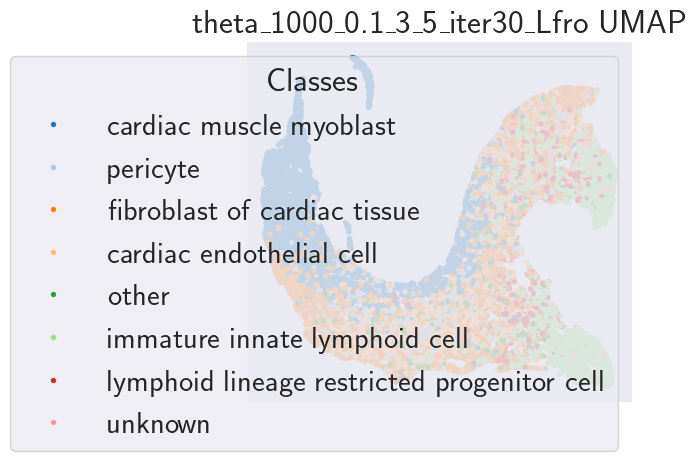

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

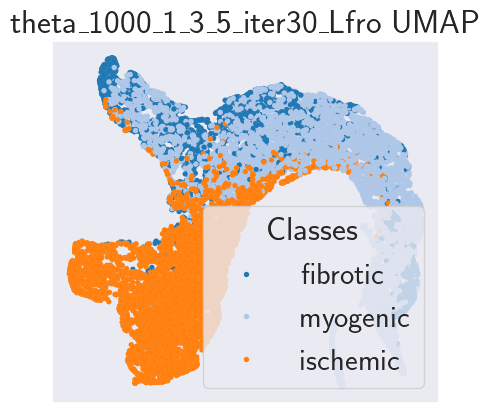

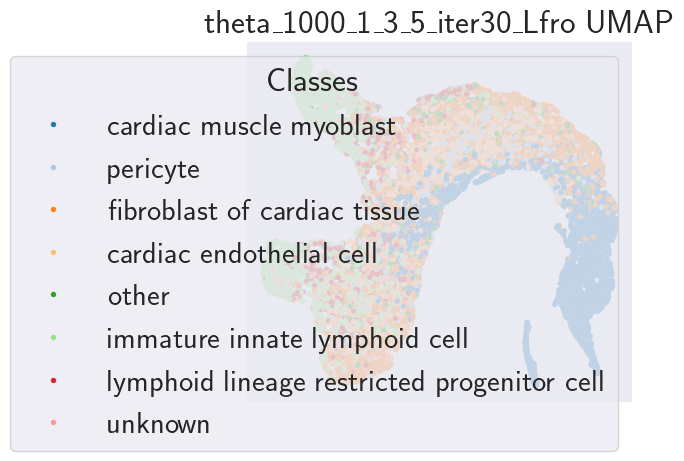

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

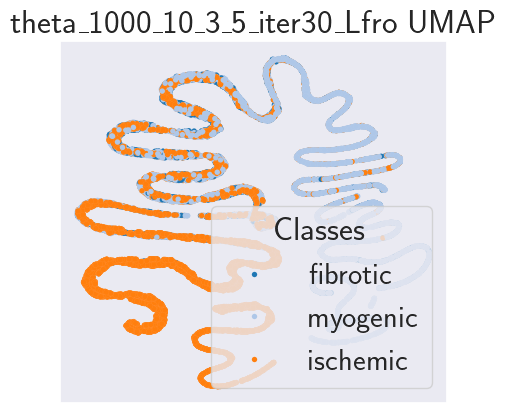

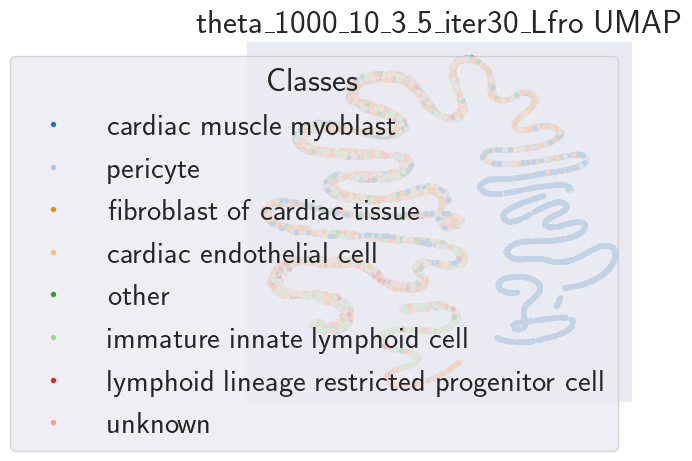

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

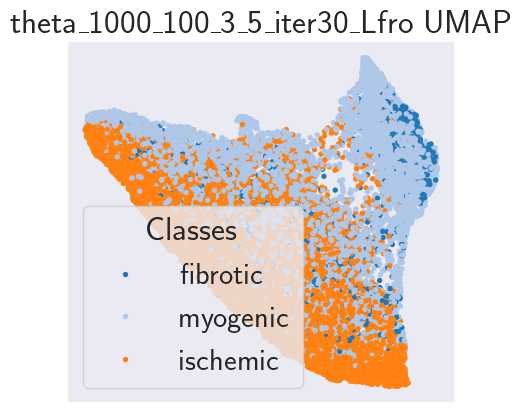

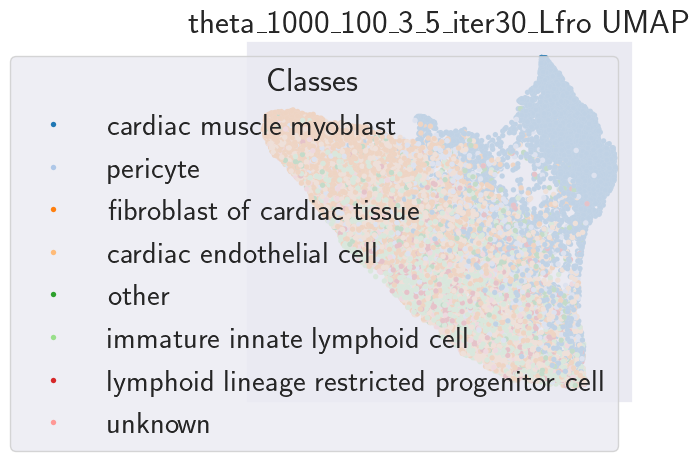

[ 0. nan  0. ...  1.  1.  1.]
[    0     2     5 ... 28578 28579 28580]
[['cardiac muscle myoblast', 'cardiac endothelial cell', 'pericyte', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'pericyte', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'cardiac muscle myoblast', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'cardiac endothelial cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'smooth muscle myoblast', 'immature innate lymphoid cell', 'cardiac endothelial cell', 'lymphoid lineage restricted progenitor cell', 'fibroblast of cardiac tissue', 'fibroblast of cardiac tissue', 'fibroblast of

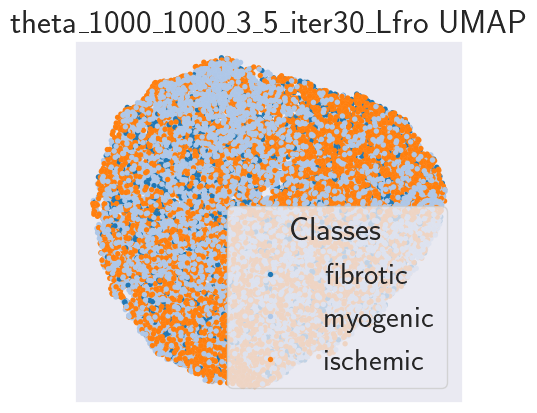

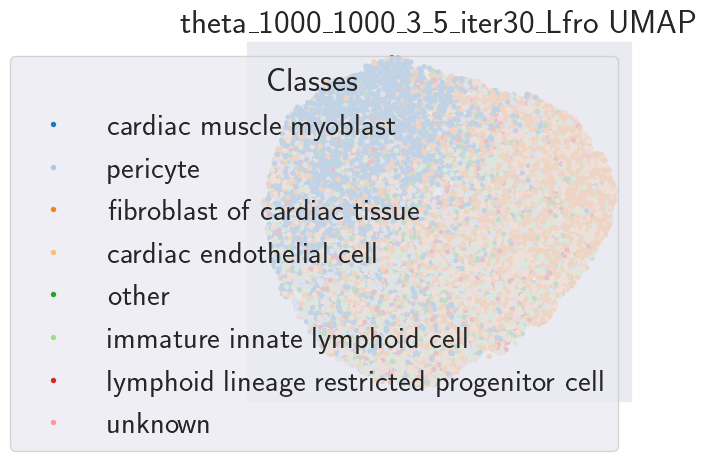

In [19]:


#print(precomputed_ground_distances[dataset_name]["GGML"])
print( datapoints_over_split.keys())
dataset_name = "myocard_infarct"
print(precomputed_ground_distances)
considered_metrics = precomputed_ground_distances[dataset_name].keys()


#metric_name = "GGML_L2" #GGML" Euclidean" #

for metric_name in considered_metrics:
    if f"{dataset_name}_{metric_name}" in datapoints_over_split:
        
        thresh = 0. #0.9
        accuracy = datapoints_over_split[f"{dataset_name}_{metric_name}"]
        print(accuracy)
        selected_cells_ind = np.where((accuracy>=thresh))[0] #np.arange((len(accuracy))) #
        print(selected_cells_ind)
        data_points = datasets[dataset_name]["points"][selected_cells_ind]
        print(datasets[dataset_name]["distribution_modes"])
        cell_types = np.concatenate(datasets[dataset_name]["distribution_modes"])[selected_cells_ind]
        #cell_types = [mapping[l] for l in cell_types]

        n_most_cells = 8
        cells_n_min = np.sort(np.unique(cell_types, return_counts=True)[1])[-(n_most_cells-1)]

        unique, counts = np.unique(cell_types, return_counts=True)
        total_other = 0
        celltype_accuracy = {}
        for u,c in zip(unique, counts):
            celltype_accuracy[u]=np.average(accuracy[selected_cells_ind][cell_types==u])
            if c < cells_n_min:
                cell_types[cell_types==u] = "other"
                total_other += c    
        print(celltype_accuracy)
        print(total_other)

        labels = np.asarray(datasets[dataset_name]["point_labels"])[selected_cells_ind]

        theta = metric_params[dataset_name][metric_name]
        print("Surivived until here")

        cell_dist = pairwise_mahalanobis_distance_npy(data_points,w = theta)

        emb1 = plot_emb(cell_dist,method='umap',colors=labels,legend="auto",title=f"{metric_name} UMAP",verbose=True,annotation=None,s=15)
        plot_emb(cell_dist,precomputed_emb=emb1,method='umap',colors=cell_types,legend="auto",title=f"{metric_name} UMAP",verbose=True,annotation=None,s=15)
        plt.show()
